In [4]:
#Load packages
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr
import os
import warnings
import functools
import seaborn as sns
import scipy.stats
import anndata
#import dandelion as ddl
import tables
from rpy2.robjects import r

In [5]:
from collections import defaultdict

In [25]:
#Create blank dictionaries 
adata_tmp = defaultdict(dict)
adata_tmp2 = defaultdict(dict)

### 1st round fine annotations

In [6]:
#Change working directory 
os.chdir("/home/jovyan/data/ClatCov/")


In [31]:
#cluster marker genes from Chua et al. Nat Biotech 2020
Chuafeat = ['TP63', 'KRT5', 'S100A2', 'FABP5', 'SERPINB3', 'TMSB4X', 'IFIT1', 'IFIT2', 'IFITM3', 'ISG15', 'ISG20', 'OAS1', 'SCGB1A1', 'SCGB3A1', 'XBP1', 'VMO1', 'MUC5AC', 'PIGR', 'FOXN4', 'CCNO', 'MYCL', 'CDC20B', 'TUBA1B', 'PCM1', 'FOXJ1', 'EFHC1', 'CCDC153', 
              'CCDC113', 'MLF1', 'LZTFL1', 'FOXI1', 'CFTR', 'ASCL3', 'FOXI2', 'SFTPB', 'ANK2', 'SFTPB', 'ANK2', 'SPRR1A', 'SPRR2A', 'SPRR2D', 'SPRR2E', 'SPRR3', 'TMPRSS11E', 'IL1B', 'VCAN', 'CD14', 'CCL2', 'FCGR3A', 'CXCL10', 'IFIT1', 'CD68', 'FABP5', 'FCER1A', 'CD74', 'HLA-DQB1',
              'HLA-DRA', 'JCHAIN', 'APOE', 'NCAM1', 'HMGB2', 'STMN1', 'FOXP3', 'CTLA4', 'TNFRSF18', 'CD4', 'CD8B', 'CD8A', 'PRF1', 'GZMA', 'GZMB', 'GNLY', 'NKG7', 'CD3G', 'CD3E', 'KLRB1', 'IL32', 'S100A4', 'CD27', 'CD19', 'MS4A1', 'CD79A', 'IRF7', 'TLR7', 'CLEC4C', 'IL3RA', 'LYN', 
              'FCGR3B', 'ITGAX', 'HPGD', 'LTC4S', 'CPA3','CD69', 'ITGA1', 'KIT', 'HBB', 'PPBP']
Chuafeat

['TP63',
 'KRT5',
 'S100A2',
 'FABP5',
 'SERPINB3',
 'TMSB4X',
 'IFIT1',
 'IFIT2',
 'IFITM3',
 'ISG15',
 'ISG20',
 'OAS1',
 'SCGB1A1',
 'SCGB3A1',
 'XBP1',
 'VMO1',
 'MUC5AC',
 'PIGR',
 'FOXN4',
 'CCNO',
 'MYCL',
 'CDC20B',
 'TUBA1B',
 'PCM1',
 'FOXJ1',
 'EFHC1',
 'CCDC153',
 'CCDC113',
 'MLF1',
 'LZTFL1',
 'FOXI1',
 'CFTR',
 'ASCL3',
 'FOXI2',
 'SFTPB',
 'ANK2',
 'SFTPB',
 'ANK2',
 'SPRR1A',
 'SPRR2A',
 'SPRR2D',
 'SPRR2E',
 'SPRR3',
 'TMPRSS11E',
 'IL1B',
 'VCAN',
 'CD14',
 'CCL2',
 'FCGR3A',
 'CXCL10',
 'IFIT1',
 'CD68',
 'FABP5',
 'FCER1A',
 'CD74',
 'HLA-DQB1',
 'HLA-DRA',
 'JCHAIN',
 'APOE',
 'NCAM1',
 'HMGB2',
 'STMN1',
 'FOXP3',
 'CTLA4',
 'TNFRSF18',
 'CD4',
 'CD8B',
 'CD8A',
 'PRF1',
 'GZMA',
 'GZMB',
 'GNLY',
 'NKG7',
 'CD3G',
 'CD3E',
 'KLRB1',
 'IL32',
 'S100A4',
 'CD27',
 'CD19',
 'MS4A1',
 'CD79A',
 'IRF7',
 'TLR7',
 'CLEC4C',
 'IL3RA',
 'LYN',
 'FCGR3B',
 'ITGAX',
 'HPGD',
 'LTC4S',
 'CPA3',
 'CD69',
 'ITGA1',
 'KIT',
 'HBB',
 'PPBP']

In [30]:
#Marker genes from Travaglini 2020 Nature 
Trav_list = ['FOXJ1','KRT5','MUC5B',
   'MUC5B',
   'PRR4',
   'CFTR',
   'CALCA',
   'DCLK1',
   'AGER',
   'SFTPB',
   'ACKR1',
   'CA4',
   'PROX1',
   'CNN1',
   'CNN1',
   'COL1A1',
   'COL1A1',
   'COL1A1',
   'CSPG4',
   'MSLN',
   'SNAP25',
   'CD79A',
   'CD79A',
   'CD3E',
   'CD3E',
   'CD3E',
   'CD3E',
   'KLRD1',
   'CD3E',
   'S100A8',
   'MS4A2',
   'MS4A2',
   'SIGLEC8',
   'NRGN',
   'MARCO',
   'LILRB4',
   'CLEC9A',
   'CD14',
  'SCGB3A2',
   'TUBB1',
   'KRT14',
   'MUC5AC',
   'LPO',
   'FOXI1',
   'CHGA',
   'ASCL2',
   'PDPN',
   'BMX',
   'PDPN',
   'ACTA2',
   'PDGFRA',
   'TRPC6',
   'UPK3B',
   'CD24',
   'CD27',
   'CD8A',
   'CD4',
   'NKG7',
   'CD8B',
   'S100A9',
   'CPA3',
   'PPBP',
   'MSR1',
   'IRF8',
   'LAMP3',
   'CD1C',
   'S100A8',
   'TP73',
   'TP63',
   'SPDEF',
   'LTF',
   'ASCL3',
   'ASCL1',
   'CLIC5',
   'TAGLN',
   'ELN',
   'PLIN2',
   'PDGFRB',
   'MS4A1',
   'SLAMF7',
   'GZMK',
   'COTL1',
   'CCR7',
   'TYROBP',
   'FCER1G',
   'IFITM2',
   'TPSAB1',
   'PF4',
   'MRC1',
   'LILRA4',
   'PLD4',
   'FCGR3A',
   'CCDC78',
   'DAPL1',
   'MUC1',
   'RGS5',
   'DES',
   'ACTA2',
   'APOE',
   'CD19',
   'DUSP2',
   'GZMB',
   'LDHB',
   'LEF1',
   'TYROBP',
   'FCGR3B',
   'OST4',
   'ETV5', 
   'LGR6']
Trav_list

['FOXJ1',
 'KRT5',
 'MUC5B',
 'MUC5B',
 'PRR4',
 'CFTR',
 'CALCA',
 'DCLK1',
 'AGER',
 'SFTPB',
 'ACKR1',
 'CA4',
 'PROX1',
 'CNN1',
 'CNN1',
 'COL1A1',
 'COL1A1',
 'COL1A1',
 'CSPG4',
 'MSLN',
 'SNAP25',
 'CD79A',
 'CD79A',
 'CD3E',
 'CD3E',
 'CD3E',
 'CD3E',
 'KLRD1',
 'CD3E',
 'S100A8',
 'MS4A2',
 'MS4A2',
 'SIGLEC8',
 'NRGN',
 'MARCO',
 'LILRB4',
 'CLEC9A',
 'CD14',
 'SCGB3A2',
 'TUBB1',
 'KRT14',
 'MUC5AC',
 'LPO',
 'FOXI1',
 'CHGA',
 'ASCL2',
 'PDPN',
 'BMX',
 'PDPN',
 'ACTA2',
 'PDGFRA',
 'TRPC6',
 'UPK3B',
 'CD24',
 'CD27',
 'CD8A',
 'CD4',
 'NKG7',
 'CD8B',
 'S100A9',
 'CPA3',
 'PPBP',
 'MSR1',
 'IRF8',
 'LAMP3',
 'CD1C',
 'S100A8',
 'TP73',
 'TP63',
 'SPDEF',
 'LTF',
 'ASCL3',
 'ASCL1',
 'CLIC5',
 'TAGLN',
 'ELN',
 'PLIN2',
 'PDGFRB',
 'MS4A1',
 'SLAMF7',
 'GZMK',
 'COTL1',
 'CCR7',
 'TYROBP',
 'FCER1G',
 'IFITM2',
 'TPSAB1',
 'PF4',
 'MRC1',
 'LILRA4',
 'PLD4',
 'FCGR3A',
 'CCDC78',
 'DAPL1',
 'MUC1',
 'RGS5',
 'DES',
 'ACTA2',
 'APOE',
 'CD19',
 'DUSP2',
 'GZMB',
 'LDHB',
 

In [29]:
#Plot ILC marker genes from Bjorkland 2016 Nature Immunology. 
ILC_Bjorkland = ['CCL3',
'CXCR3',
'IFNG',
'IL12RB1',
'TBX21',
'PTGDR2',
'IL17RB',
'IL1RL1',
'IL13',
'GATA3',
'NCR2',
'IL22',
'RORC',
'AHR',
'IL23R',
'IL1R1',
'EOMES',
'GZMA',
'GNLY',
'KLRC1']

In [97]:
ILC_Bjorkland

['TRGV3',
 'TRGV2',
 'IL7R',
 'TMEM176B',
 'IL2RA',
 'CXCR6',
 'SOCS2',
 'CKB',
 'TMEM176A',
 'PODNL1',
 'ST6GALNAC3',
 'TMEM154',
 'CDON',
 'ATP8A2',
 'SLC27A6',
 'RORA',
 'GATA3',
 'KIT']

In [4]:
#load filtered broad labelled object
adata_concat = sc.read_h5ad('COV_combined_broad_label_020721.h5ad')
adata_concat

AnnData object with n_obs × n_vars = 456439 × 1329
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Cohort_colors', 'Gender_colors', 'Patient_colors', 'Sampleid_colors', 'Sampletype_colors', 'broad_label_colors', 'celltypist_colors', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors',

In [6]:
#Check percent_mito is defunct and pct_counts_mt should be used. 
adata_concat.obs['percent_mito']

CGCTTCACAAGAAGAG-1-0-0         NaN
GGACATTCATAGACTC-1-0-0         NaN
GCACATAGTAAGGATT-1-0-0         NaN
GACGTGCTCGTAGATC-1-0-0         NaN
CTCTGGTAGTACGTAA-1-0-0         NaN
                            ...   
TTTGTCAGTGGTAACG-1-7-1    4.719324
TTTGTCAGTTGCGTTA-1-7-1    4.663992
TTTGTCATCAACCAAC-1-7-1    3.098927
TTTGTCATCCGCAGTG-1-7-1    5.124451
TTTGTCATCGTAGGAG-1-7-1    3.686636
Name: percent_mito, Length: 456439, dtype: float64

In [5]:
adata_concat.obs['pct_counts_mt']

CGCTTCACAAGAAGAG-1-0-0    1.572898
GGACATTCATAGACTC-1-0-0    2.281926
GCACATAGTAAGGATT-1-0-0    1.988804
GACGTGCTCGTAGATC-1-0-0    0.655712
CTCTGGTAGTACGTAA-1-0-0    0.591825
                            ...   
TTTGTCAGTGGTAACG-1-7-1    4.749938
TTTGTCAGTTGCGTTA-1-7-1    4.701719
TTTGTCATCAACCAAC-1-7-1    3.074141
TTTGTCATCCGCAGTG-1-7-1    5.200594
TTTGTCATCGTAGGAG-1-7-1    3.733956
Name: pct_counts_mt, Length: 456439, dtype: float32

In [5]:
#percent_mito and n_counts are only for Soupx object, and have been calculated using scanpy
#calulate_qc_metrics de novo for all cells, so drop the redundant percent_mito and n_counts columns
#Use total_counts and pct_counts_mt instead
del adata_concat.obs['percent_mito']
del adata_concat.obs['n_counts']
adata_concat

AnnData object with n_obs × n_vars = 456439 × 1329
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Cohort_colors', 'Gender_colors', 'Patient_colors', 'Sampleid_colors', 'Sampletype_colors', 'broad_label_colors', 'celltypist_colors', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'rank_g

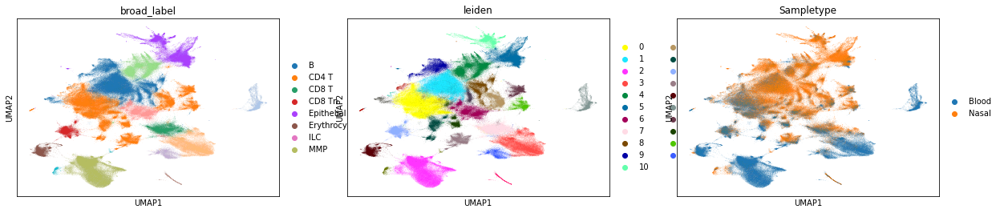

In [9]:
#Visualise 
sc.pl.umap(adata_concat, color=['broad_label','leiden', 'Sampletype'])

## Sub-clustering for fine cell type annotation

#First create a new column called `leiden_R_label` which I will update as I progress through.

In [6]:
#Create new slot for labels in main object. 
adata_concat.obs['fine_label'] = adata_concat.obs['leiden']

In [10]:
#Check 
adata_concat

AnnData object with n_obs × n_vars = 456439 × 1329
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Cohort_colors', 'Gender_colors', 'Patient_colors', 'Sampleid_colors', 'Sampletype_colors', 'broad_label_colors', 'celltypist_colors', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 

### T cell

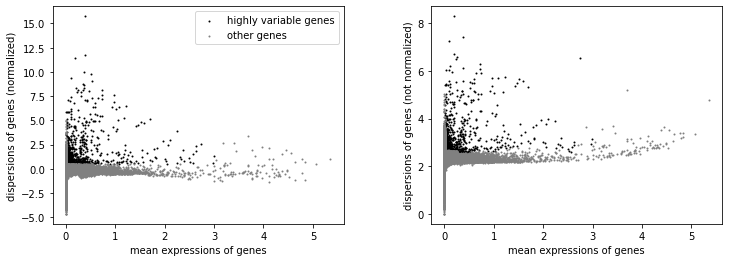

AnnData object with n_obs × n_vars = 180610 × 25675
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg'

In [96]:
# subset
rna_ = adata_concat[adata_concat.obs['leiden'].isin(['0','6','7','11','12','13','14','17','18','19','20','23','24','26','27','28'])]
rna_x = sc.AnnData(X = rna_.raw.X, obs = rna_.obs, var = rna_.raw.var)
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

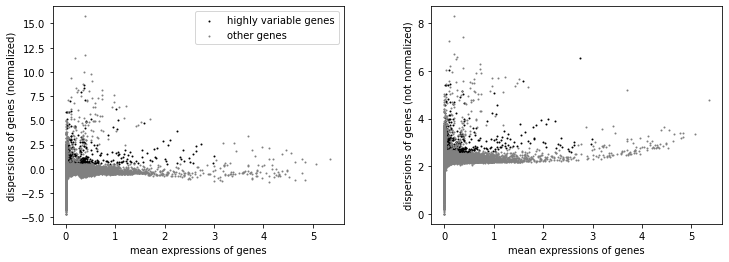

In [97]:
## remove TRBV/TRAV and IGHV/IGLV/IGKV from the highly variable genes
## allow for TRGV and TRDV so that i can do fine labelling for them
import re
for i in rna_x.var.index:
    if re.search('^TR[AB]V|^IG[HKL]V', i):
        rna_x.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(rna_x)

In [98]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]


In [99]:
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['total_counts', 'pct_counts_mt'])


In [100]:
sc.pp.scale(rna_x, max_value = 10)

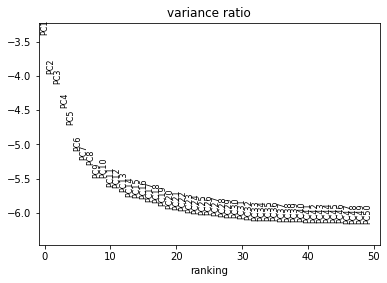

In [101]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

In [102]:
# Computing the neighborhood graph. Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50)

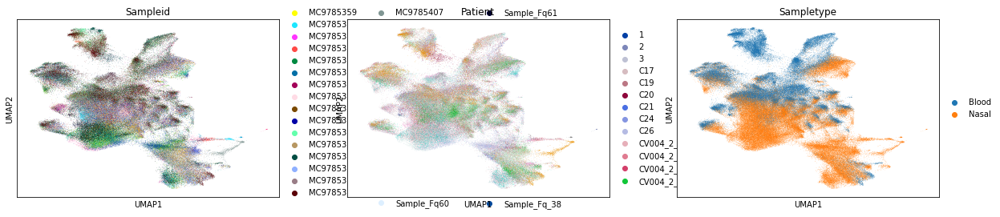

In [103]:
# run UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

In [105]:
# run harmony
sc.external.pp.harmony_integrate(rna_x, 'Patient')
'X_pca_harmony' in rna_x.obsm


2021-07-06 08:19:18,872 - harmonypy - INFO - Iteration 1 of 10
2021-07-06 08:21:56,427 - harmonypy - INFO - Iteration 2 of 10
2021-07-06 08:24:33,543 - harmonypy - INFO - Iteration 3 of 10
2021-07-06 08:26:57,263 - harmonypy - INFO - Converged after 3 iterations


True

In [106]:
#Check 
rna_x

AnnData object with n_obs × n_vars = 180610 × 915
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'pca', 'neighbors', 'umap', 'Sampleid_colors', 'Patient_colors', 'Sampletype_colors', 'leiden_colors'
    obsm: 'X_pca', 'X_umap', 'X_pca_harmony'
    varm: 'PCs'
    obsp: 'distances', 'connectivi

In [107]:
# Compute the neighborhood graph correcting for batch using harmony PCA. Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50, use_rep='X_pca_harmony')

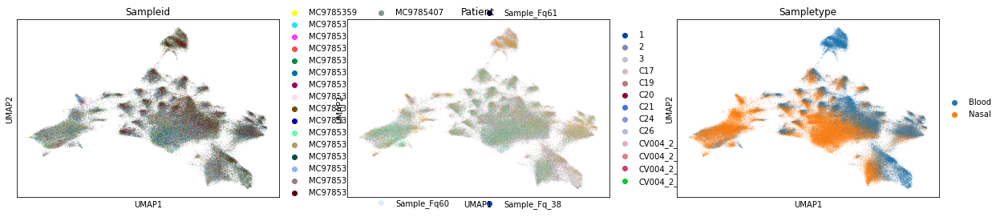

In [109]:
# UMAP - harmony corrected. 
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

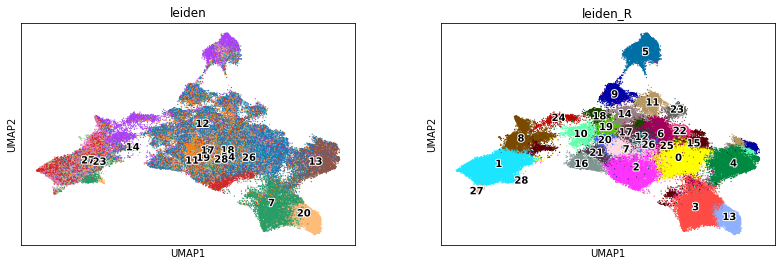

In [130]:
# find clusters in subsetted object. 
sc.tl.leiden(rna_x, resolution = 1, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=6, legend_loc ='on data', legend_fontoutline=2)

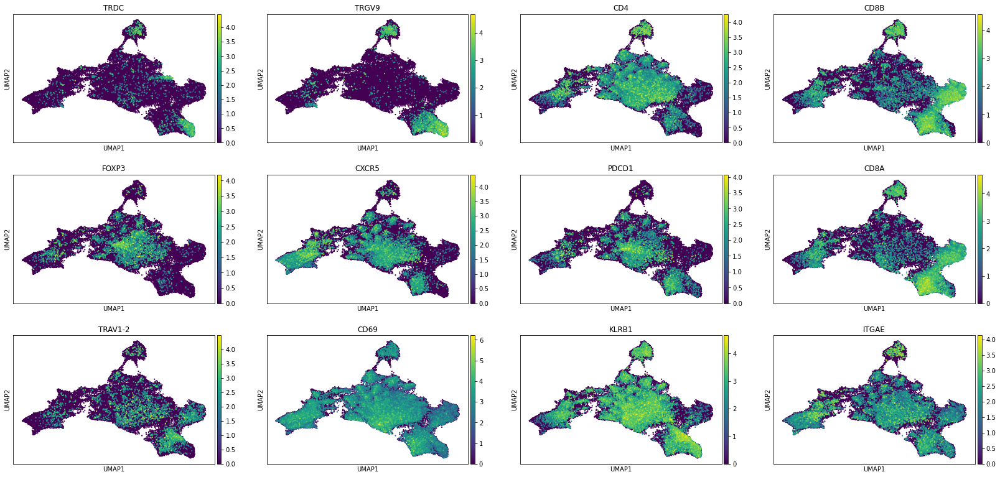

In [113]:
#Where are key marker genes for t cell subsets expressed? 
sc.pl.umap(rna_x, color = ['TRDC', 'TRGV9', 'CD4', 'CD8B', 'FOXP3', 'CXCR5', 'PDCD1', 'CD8A','TRAV1-2', 'CD69', 'KLRB1','ITGAE'], size = 20)

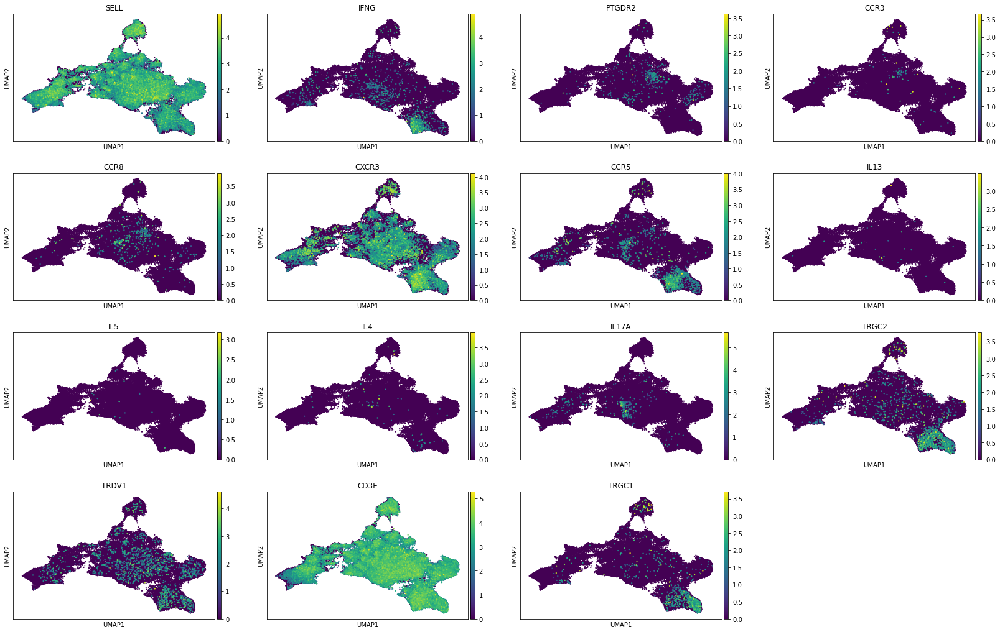

In [155]:
sc.pl.umap(rna_x, color = ['SELL', 'IFNG', 'PTGDR2','CCR3','CCR8','CXCR3','CCR5','IL13', 'IL5', 'IL4', 'IL17A', 'TRGC2', 'TRDV1', 'CD3E','TRGC1'], size = 20)

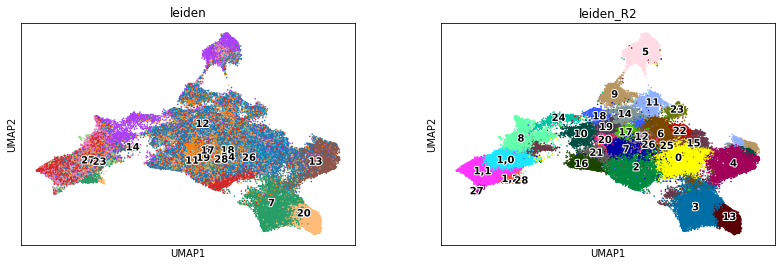

In [131]:
# split specific clusters based on gene expression profiles
sc.tl.leiden(rna_x, resolution = .3, key_added = 'leiden_R2', restrict_to =('leiden_R', ['1']))
sc.pl.umap(rna_x, color=['leiden', 'leiden_R2'], size=10, legend_loc ='on data', legend_fontoutline=2)

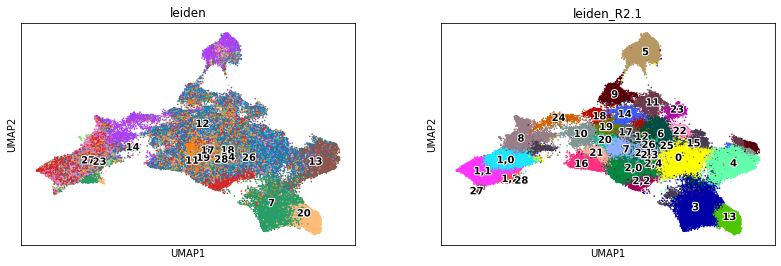

In [140]:
# split specific clusters
sc.tl.leiden(rna_x, resolution = .3, key_added = 'leiden_R2.1', restrict_to =('leiden_R2', ['2']))
sc.pl.umap(rna_x, color=['leiden', 'leiden_R2.1'], size=10, legend_loc ='on data', legend_fontoutline=2)

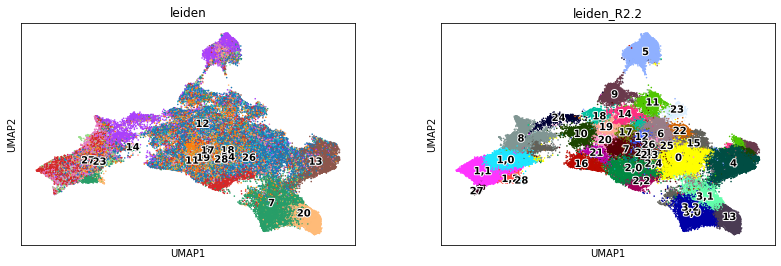

In [141]:
# split specific clusters
sc.tl.leiden(rna_x, resolution = .3, key_added = 'leiden_R2.2', restrict_to =('leiden_R2.1', ['3']))
sc.pl.umap(rna_x, color=['leiden', 'leiden_R2.2'], size=10, legend_loc ='on data', legend_fontoutline=2)

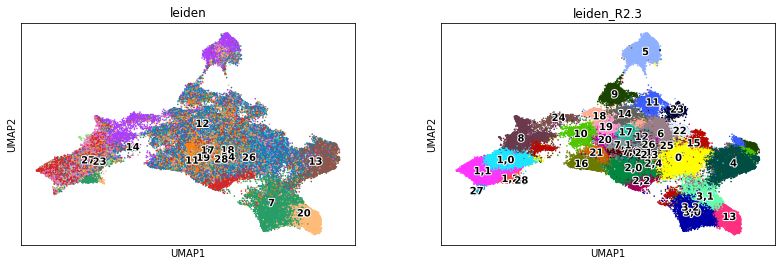

In [142]:
# split specific clusters
sc.tl.leiden(rna_x, resolution = .2, key_added = 'leiden_R2.3', restrict_to =('leiden_R2.2', ['7']))
sc.pl.umap(rna_x, color=['leiden', 'leiden_R2.3'], size=10, legend_loc ='on data', legend_fontoutline=2)

categories: 0, 1,0, 1,1, etc.
var_group_labels: 1,0, 1,1, 1,2, etc.


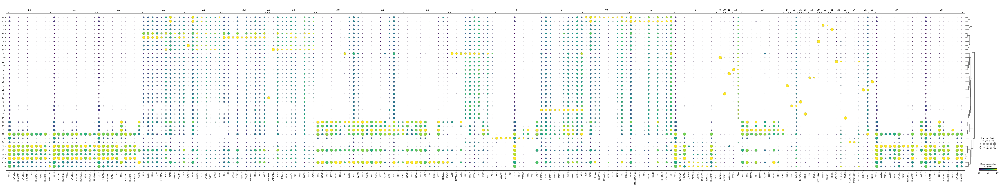

In [143]:
#Rank top 10 DEG by cluster and plot. 
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R2.3', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R2.3')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

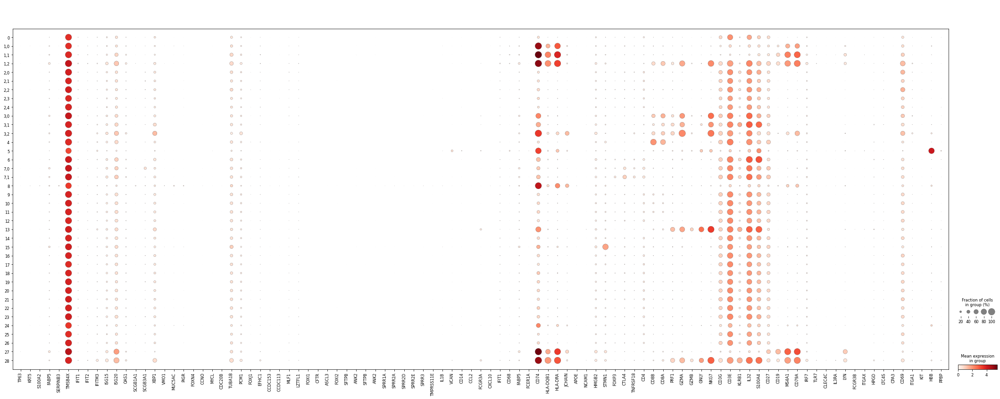

In [144]:
#Plot Chua 2020 nasal covid marker genes. 
sc.pl.dotplot(rna_x, Chuafeat, groupby = 'leiden_R2.3')

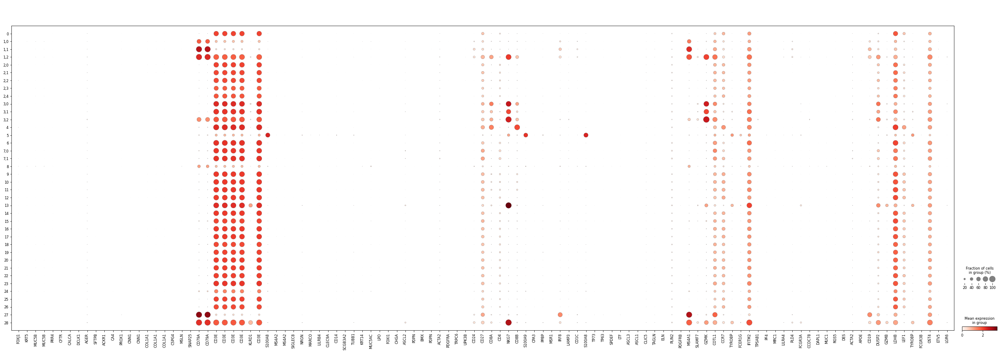

In [145]:
#Plot travaglini 2020 lung marker genes. 
sc.pl.dotplot(rna_x, Trav_list, groupby = 'leiden_R2.3')

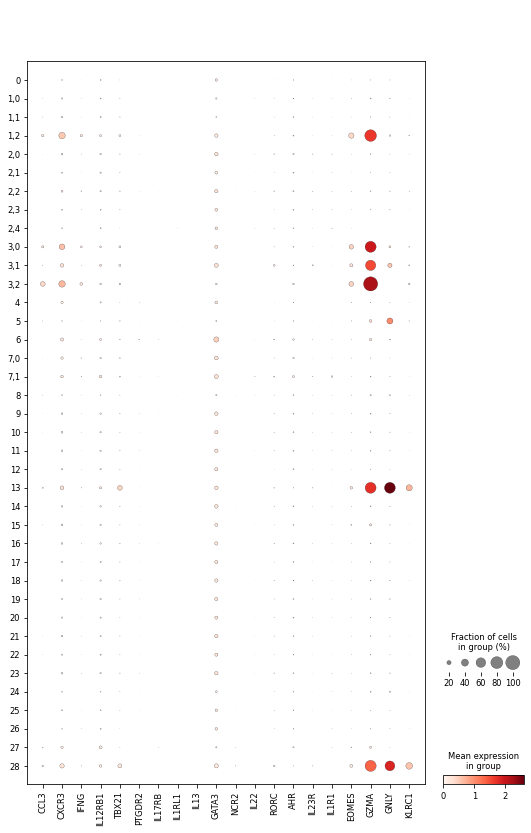

In [146]:
#Plot Bjorkland ILC marker genes. 
sc.pl.dotplot(rna_x, ILC_Bjorkland, groupby = 'leiden_R2.3')

In [28]:
Zhang2020_T = ['CD3E',
              'CD4',
              'CD8A',
              'CCR7',
              'SELL',
              'TCF7',
              'LEF1',
              'LTB',
              'S100A4',
              'GPR183',
              'CD69',
              'GZMK',
              'GZMA',
              'GZMB',
              'GNLY',
              'NKG7',
              'FOXP3',
              'IL2RA',
              'TIGIT',
              'HAVCR2',
              'CTLA4',
              'LAG3',
              'PDCD1',
              'TOX',
              'FCGR3A',
              'KIR3DL2',
              'TYROBP',
              'NCAM1',
              'CD160']

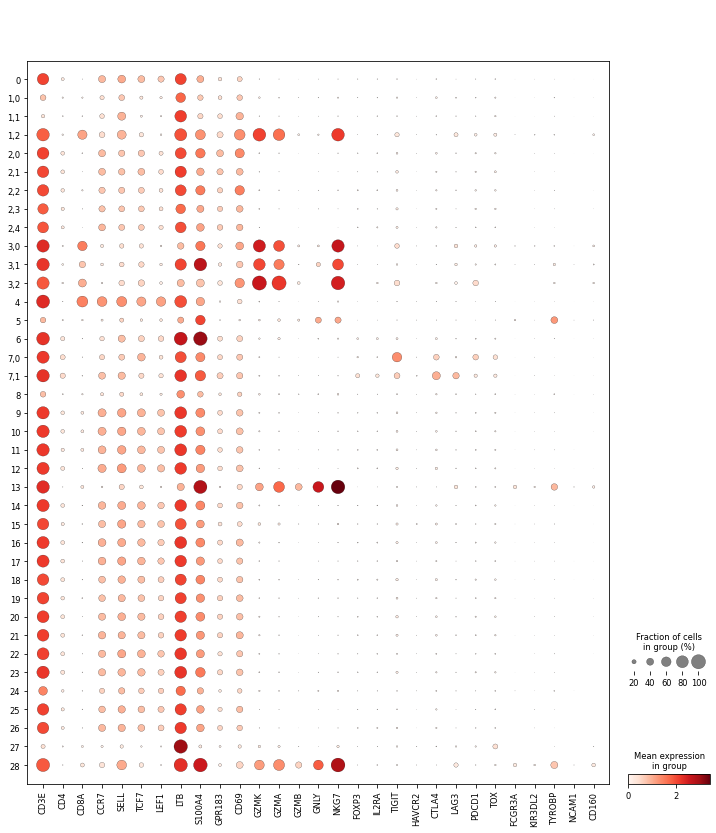

In [147]:
#Plot T cells subset markers from Zhang 2021 Nature Immuno covid paper blood/balf. 
sc.pl.dotplot(rna_x, Zhang2020_T, groupby = 'leiden_R2.3')

... storing 'fine_label' as categorical


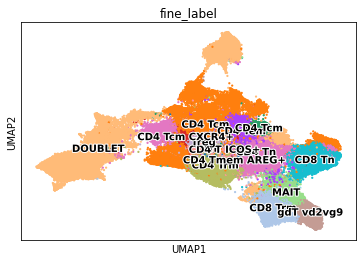

In [157]:
#Name clusters based on DEG and published marker gene expression. 
new_dict1 = {'0':'CD4 Tn',
             '1,0':'DOUBLET',
             '1,1':'DOUBLET',
             '1,2':'DOUBLET',
             '2,0':'CD4 Trm',
             '2,1':'CD4 T ICOS+',
             '2,2':'CD4 Trm',
             '2,3':'CD4 Tcm',
             '2,4':'CD4 Tmem AREG+',
             '3,0':'CD8 Trm',
             '3,1':'MAIT',
             '3,2':'DOUBLET',
             '4':'CD8 Tn',
             '5':'DOUBLET',
             '6':'CD4 Tem',
             '7,0':'Tfh',
             '7,1':'Treg',
             '8':'DOUBLET',
             '9':'CD4 Tcm',
             '10':'CD4 Tn',
             '11':'CD4 Tcm',
             '12':'CD4 Tcm',
             '13':'gdT vd2vg9',
             '14':'CD4 Tcm',
             '15':'DOUBLET',
             '16':'CD4 Tcm',
             '17':'CD4 Tcm',
             '18':'CD4 Tcm',
             '19':'CD4 Tcm',
             '20':'CD4 Tcm CXCR4+',
             '21':'CD4 Tcm',
             '22':'CD4 Tcm ',
             '23':'CD4 Tcm',
             '24':'DOUBLET',
             '25':'CD4 Tn',
             '26':'CD4 Tcm',
             '27':'DOUBLET',
            '28':'DOUBLET'}
rna_x.obs['fine_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R2.3']]
sc.pl.umap(rna_x, color=['fine_label'], size=20, legend_loc ='on data', legend_fontoutline=2)

In [158]:
adata_concat

AnnData object with n_obs × n_vars = 456439 × 1329
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Cohort_colors', 'Gender_colors', 'Patient_colors', 'Sampleid_colors', 'Sampletype_colors', 'broad_label_colors', 'celltypist_colors', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 

... storing 'fine_label' as categorical


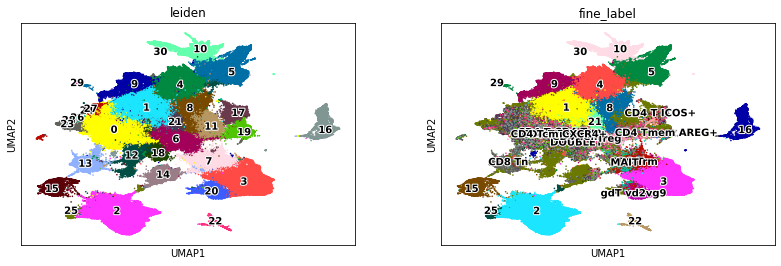

In [159]:
# update the original object
adata_concat.obs['fine_label'] = adata_concat.obs['fine_label'].astype('object')
adata_concat.obs['fine_label'].update(rna_x.obs['fine_label'].astype('object'))
sc.pl.umap(adata_concat, color = ['leiden', 'fine_label'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

In [160]:
#save for now
adata_concat.write('COV_combined_T-fine_label_060721.h5ad', compression = 'gzip')
adata_concat.raw.to_adata().write('COV_combined_T_fine_label_raw_060721.h5ad', compression = 'gzip')

In [ ]:
#need to recluster T cells without doublets, but do this later in next itteration of object. . 

### NK cell

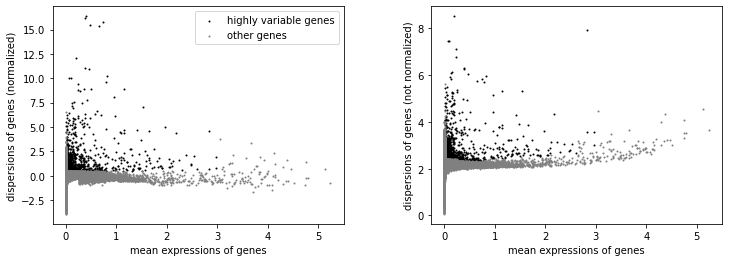

AnnData object with n_obs × n_vars = 31971 × 25675
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'Cohort_colors', 'Gender_colors', 'Patient_colors', 'Sampleid_colors', 'Sampletype_colors', 'broad_label_colors', 'celltypist_colors', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'rank_ge

In [164]:
# subset NK cells
rna_ = adata_concat[adata_concat.obs['leiden'].isin(['3'])]
rna_x = sc.AnnData(X = rna_.raw.X, obs = rna_.obs, var = rna_.raw.var, uns = rna_.uns, obsm = rna_.obsm, obsp = rna_.obsp)
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

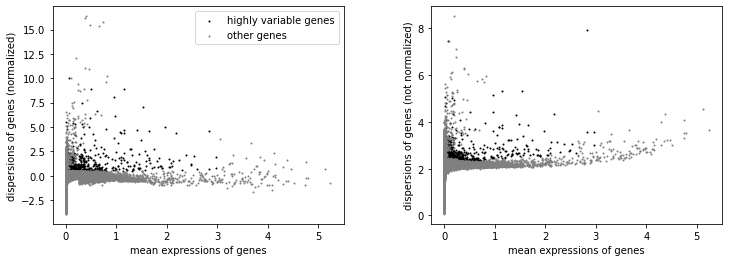

In [165]:
## remove TRBV/TRAV and IGHV/IGLV/IGKV from the highly variable genes
## keep TCR gammadelta genes
import re
for i in rna_x.var.index:
    if re.search('^TR[AB]V|^IG[HKL]V', i):
        rna_x.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(rna_x)

In [166]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['total_counts', 'pct_counts_mt'])
sc.pp.scale(rna_x, max_value = 10)

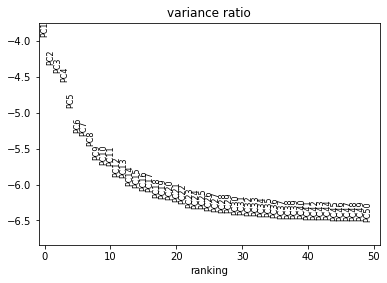

In [167]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

In [168]:
# Computing the neighborhood graph. Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50)

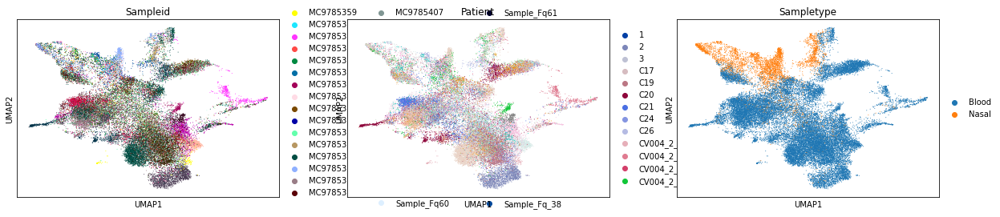

In [169]:
# run UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

In [171]:
# run harmony for bathc correction 
sc.external.pp.harmony_integrate(rna_x, 'Patient')
'X_pca_harmony' in rna_x.obsm


2021-07-06 18:31:23,328 - harmonypy - INFO - Iteration 1 of 10
2021-07-06 18:31:48,832 - harmonypy - INFO - Iteration 2 of 10
2021-07-06 18:32:12,859 - harmonypy - INFO - Iteration 3 of 10
2021-07-06 18:32:36,741 - harmonypy - INFO - Iteration 4 of 10
2021-07-06 18:32:48,742 - harmonypy - INFO - Iteration 5 of 10
2021-07-06 18:33:08,443 - harmonypy - INFO - Converged after 5 iterations


True

In [173]:
#Check 
rna_x

AnnData object with n_obs × n_vars = 31971 × 1256
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Cohort_colors', 'Gender_colors', 'Patient_colors', 'Sampleid_colors', 'Sampletype_colors', 'broad_label_colors', 'celltypist_colors', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'neighbors', '

In [174]:
# Compute the neighborhood graph for the harmony corrected object. Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50, use_rep='X_pca_harmony')

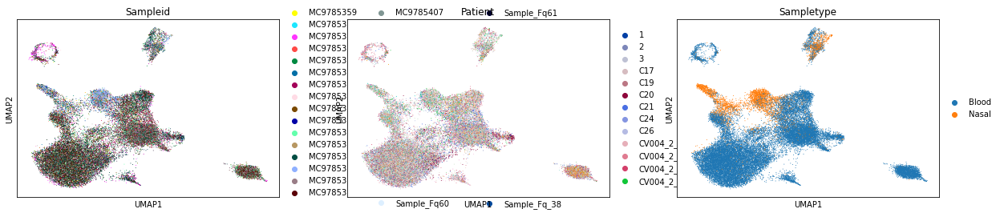

In [175]:
# UMAP of harmony batch corrected object. 
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

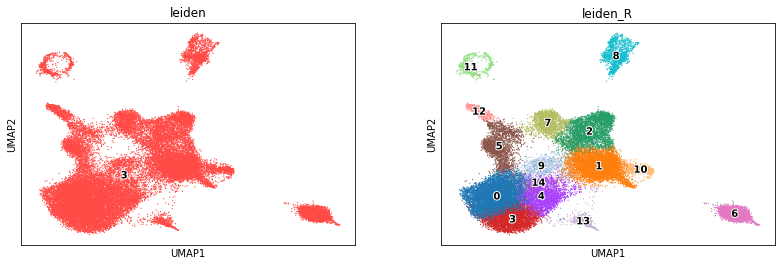

In [180]:
# find subset leiden clusters
sc.tl.leiden(rna_x, resolution = 1, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=6, legend_loc ='on data', legend_fontoutline=2)

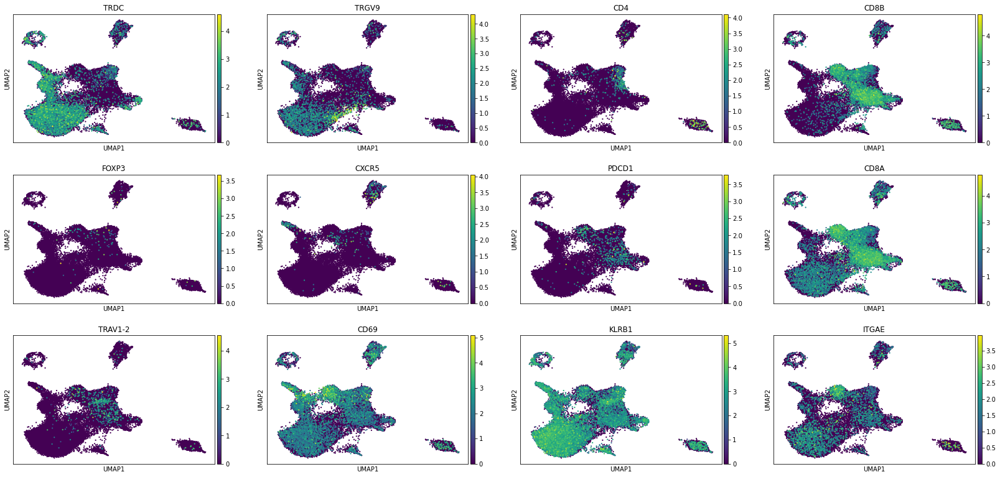

In [181]:
#Look at NK/GDT/CD8/MAIT marker genes
sc.pl.umap(rna_x, color = ['TRDC', 'TRGV9', 'CD4', 'CD8B', 'FOXP3', 'CXCR5', 'PDCD1', 'CD8A','TRAV1-2', 'CD69', 'KLRB1','ITGAE'], size = 20)

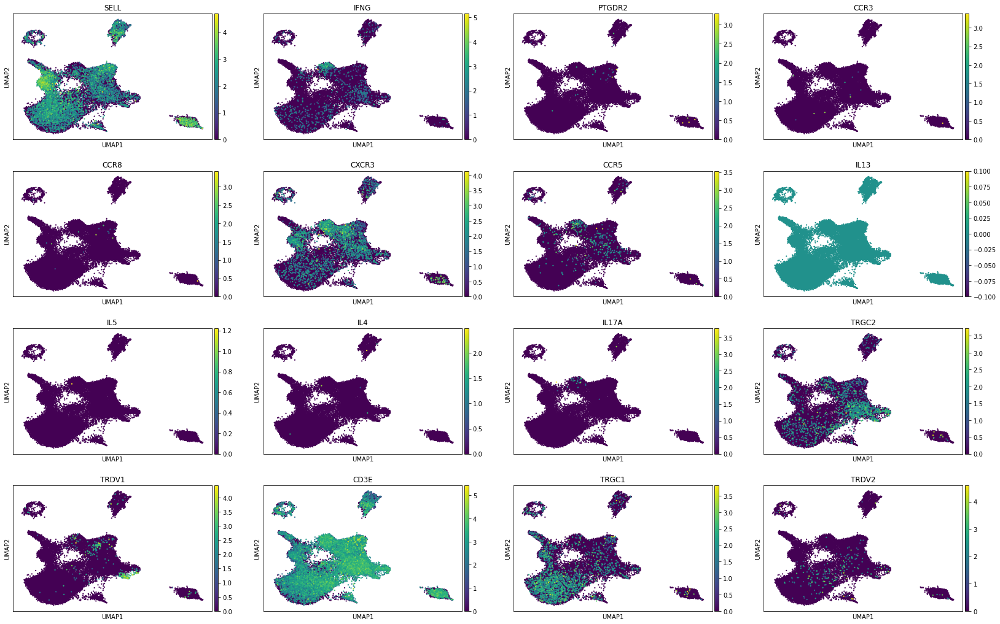

In [183]:
sc.pl.umap(rna_x, color = ['SELL', 'IFNG', 'PTGDR2','CCR3','CCR8','CXCR3','CCR5','IL13', 'IL5', 'IL4', 'IL17A', 'TRGC2', 'TRDV1', 'CD3E','TRGC1', 'TRDV2'], size = 20)

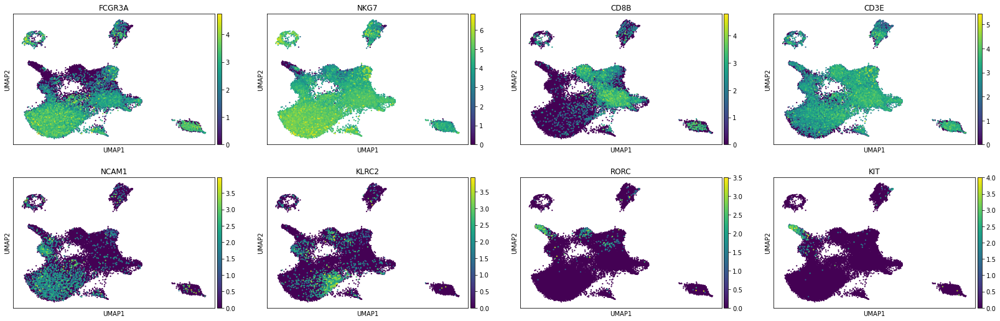

In [210]:
sc.pl.umap(rna_x, color = ['FCGR3A', 'NKG7','CD8B','CD3E','NCAM1','KLRC2','RORC','KIT'], size = 20)

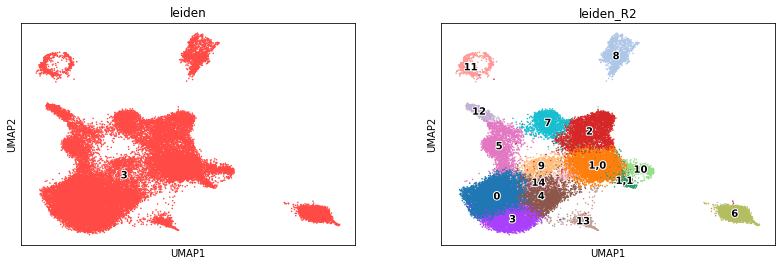

In [185]:
# split specific clusters based on gene expression 
sc.tl.leiden(rna_x, resolution = .3, key_added = 'leiden_R2', restrict_to =('leiden_R', ['1']))
sc.pl.umap(rna_x, color=['leiden', 'leiden_R2'], size=10, legend_loc ='on data', legend_fontoutline=2)

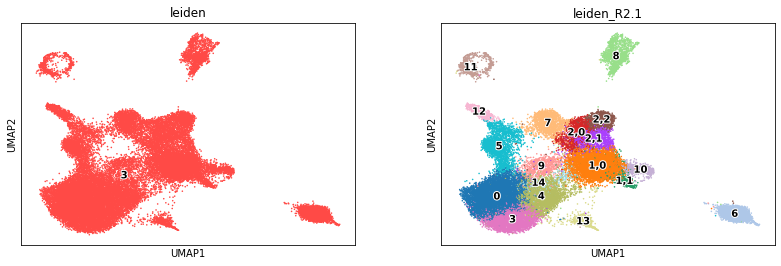

In [189]:
# split specific clusters
sc.tl.leiden(rna_x, resolution = .4, key_added = 'leiden_R2.1', restrict_to =('leiden_R2', ['2']))
sc.pl.umap(rna_x, color=['leiden', 'leiden_R2.1'], size=10, legend_loc ='on data', legend_fontoutline=2)

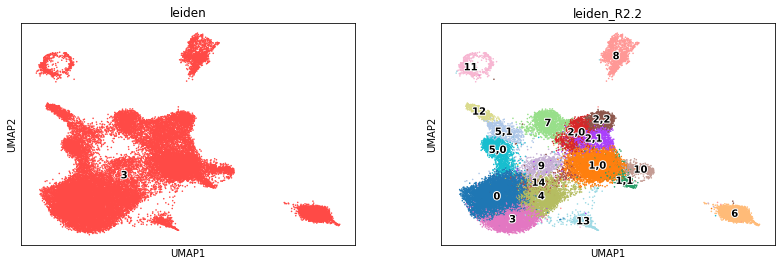

In [203]:
# split specific clusters
sc.tl.leiden(rna_x, resolution = .3, key_added = 'leiden_R2.2', restrict_to =('leiden_R2.1', ['5']))
sc.pl.umap(rna_x, color=['leiden', 'leiden_R2.2'], size=10, legend_loc ='on data', legend_fontoutline=2)

categories: 0, 1,0, 1,1, etc.
var_group_labels: 0, 1,0, 1,1, etc.


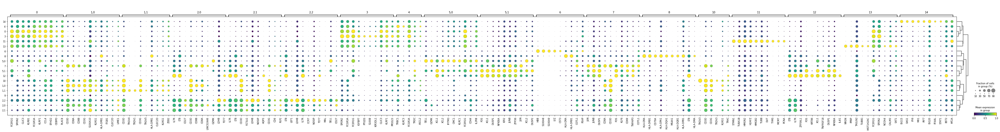

In [204]:
#Top 10 DEG dotplots 
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R2.2', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R2.2')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

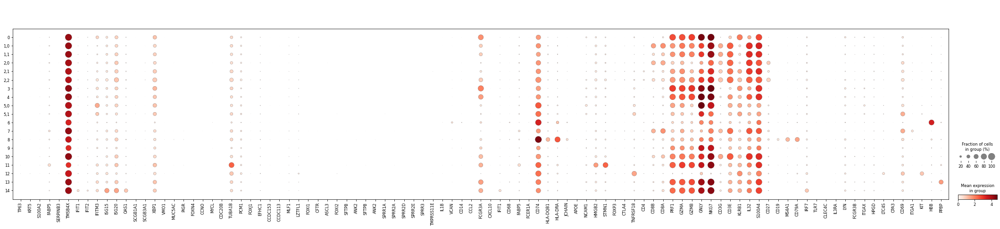

In [205]:
#Chua 2020 gene expression profiles by cluster 
sc.pl.dotplot(rna_x, Chuafeat, groupby = 'leiden_R2.2')

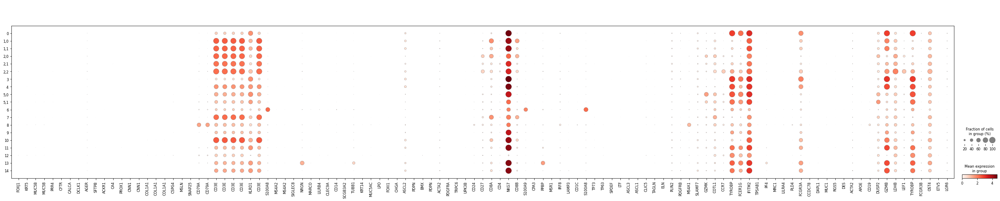

In [206]:
sc.pl.dotplot(rna_x, Trav_list, groupby = 'leiden_R2.2')

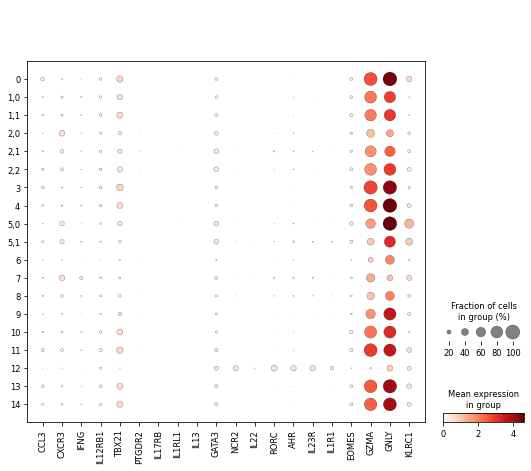

In [207]:
#Travagliini genen expression profiles by cluster 
sc.pl.dotplot(rna_x, ILC_Bjorkland, groupby = 'leiden_R2.2')

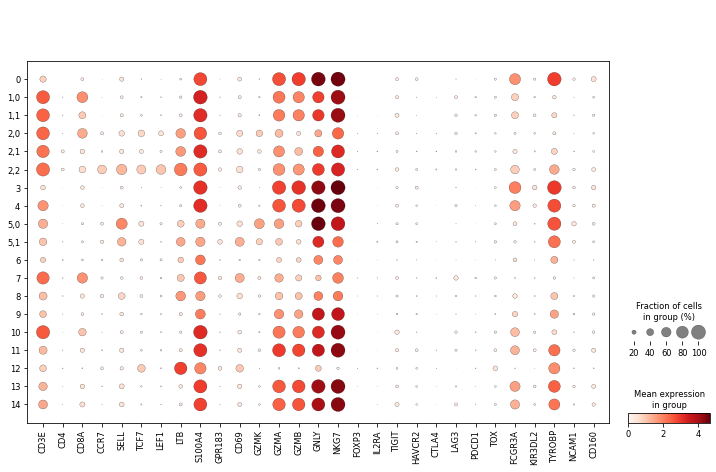

In [208]:
#Zhang T cell gene expression porfolies by cluster 
sc.pl.dotplot(rna_x, Zhang2020_T, groupby = 'leiden_R2.2')

... storing 'fine_label' as categorical


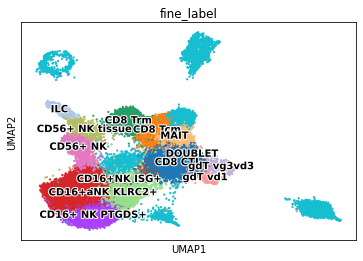

In [213]:
#Name clusters based on gene expression profiles 
new_dict1 = {'0':'CD16+ NK',
             '1,0':'CD8 CTL',
             '1,1':'gdT vd1',
             '2,0':'CD8 Tcm',
             '2,1':'MAIT',
             '2,2':'DOUBLET',
             '3':'CD16+ NK PTGDS+',
             '4':'aNK KLRC2+',
             '5,0':'CD56+ NK',
             '5,1':'CD56+ NK tissue',
             '6':'DOUBLET',
             '7':'CD8 Trm',
             '8':'DOUBLET',
             '9':'DOUBLET',
             '10':'gdT vg3vd3',
             '11':'DOUBLET',
             '12':'ILC',
             '13':'DOUBLET',
             '14':'CD16+NK ISG+'
             }
rna_x.obs['fine_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R2.2']]
sc.pl.umap(rna_x, color=['fine_label'], size=20, legend_loc ='on data', legend_fontoutline=2)

... storing 'fine_label' as categorical


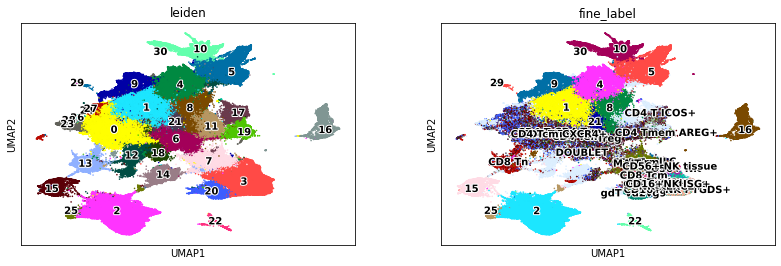

In [214]:
# update the original object with leiden clsuter 3 subset annotations 
adata_concat.obs['fine_label'] = adata_concat.obs['fine_label'].astype('object')
adata_concat.obs['fine_label'].update(rna_x.obs['fine_label'].astype('object'))
sc.pl.umap(adata_concat, color = ['leiden', 'fine_label'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

In [215]:
#save for now
adata_concat.write('COV_combined_TNK-fine_label_060721.h5ad', compression = 'gzip')
adata_concat.raw.to_adata().write('COV_combined_TNK_fine_label_raw_060721.h5ad', compression = 'gzip')

### B cells

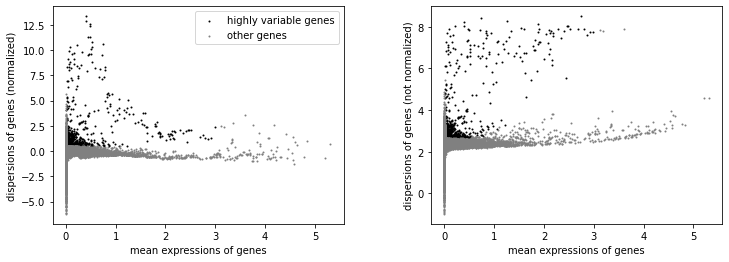

AnnData object with n_obs × n_vars = 122984 × 25675
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'Cohort_colors', 'Gender_colors', 'Patient_colors', 'Sampleid_colors', 'Sampletype_colors', 'broad_label_colors', 'celltypist_colors', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'rank_g

In [218]:
# subset B and plasma broad labelled clusters 
rna_ = adata_concat[adata_concat.obs['leiden'].isin(['1', '4', '8','9','21'])]
rna_x = sc.AnnData(X = rna_.raw.X, obs = rna_.obs, var = rna_.raw.var, uns = rna_.uns, obsm = rna_.obsm, obsp = rna_.obsp)
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

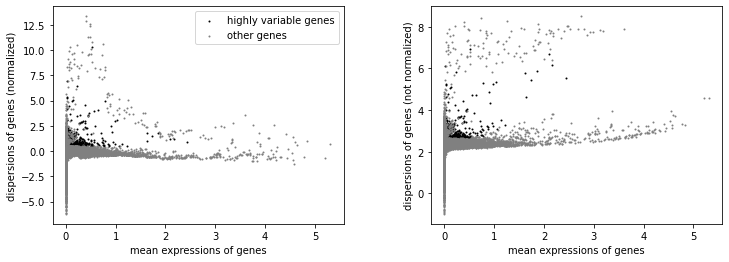

In [219]:
## remove TRBV/TRAV and IGHV/IGLV/IGKV from the highly variable genes
import re
for i in rna_x.var.index:
    if re.search('^TR[AB]V|^IG[HKL]V', i):
        rna_x.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(rna_x)

In [220]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['total_counts', 'pct_counts_mt'])
sc.pp.scale(rna_x, max_value = 10)

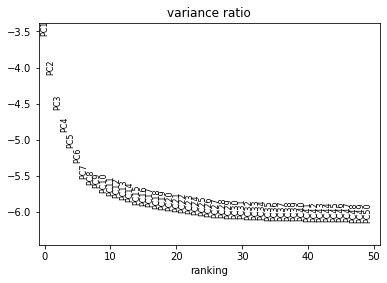

In [221]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

In [222]:
# Computing the neighborhood graph. Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50)

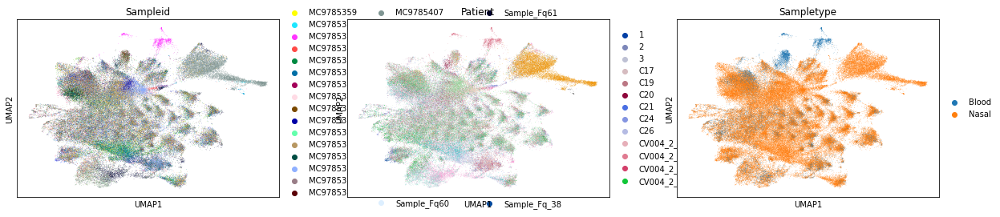

In [223]:
# run UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

In [225]:
# run harmony batch correction 
sc.external.pp.harmony_integrate(rna_x, 'Patient')
'X_pca_harmony' in rna_x.obsm


2021-07-06 22:02:39,250 - harmonypy - INFO - Iteration 1 of 10
2021-07-06 22:04:40,936 - harmonypy - INFO - Iteration 2 of 10
2021-07-06 22:06:37,767 - harmonypy - INFO - Iteration 3 of 10
2021-07-06 22:08:35,830 - harmonypy - INFO - Converged after 3 iterations


True

In [226]:
rna_x

AnnData object with n_obs × n_vars = 122984 × 946
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Cohort_colors', 'Gender_colors', 'Patient_colors', 'Sampleid_colors', 'Sampletype_colors', 'broad_label_colors', 'celltypist_colors', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'neighbors', '

In [227]:
# Compute the neighborhood graph with harmony batch correction. Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50, use_rep='X_pca_harmony')

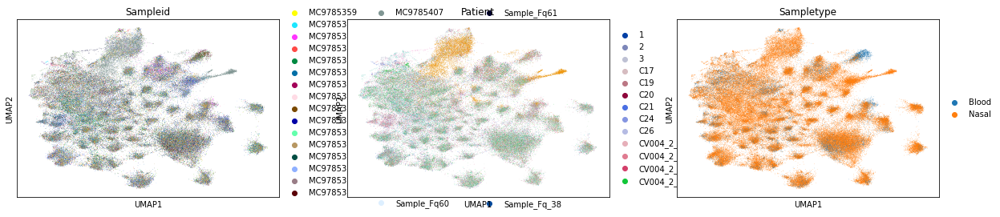

In [228]:
# UMAP of harmony corrected object 
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

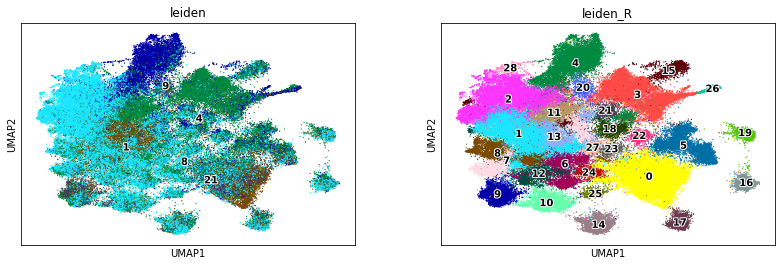

In [239]:
# find clusters in subsetted object 
sc.tl.leiden(rna_x, resolution = 0.5, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=6, legend_loc ='on data', legend_fontoutline=2)

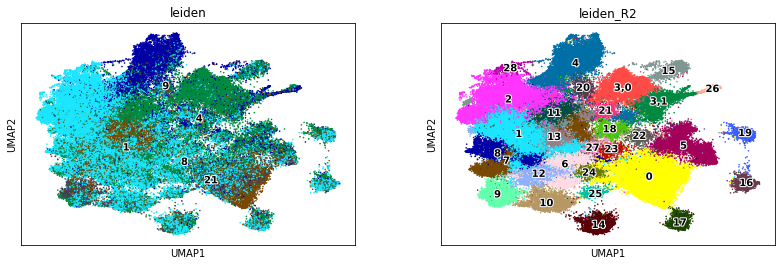

In [241]:
# split clusters
sc.tl.leiden(rna_x, resolution = .2, key_added = 'leiden_R2', restrict_to = ('leiden_R', ['3']))
sc.pl.umap(rna_x, color=['leiden', 'leiden_R2'], size=10, legend_loc ='on data', legend_fontoutline=2)

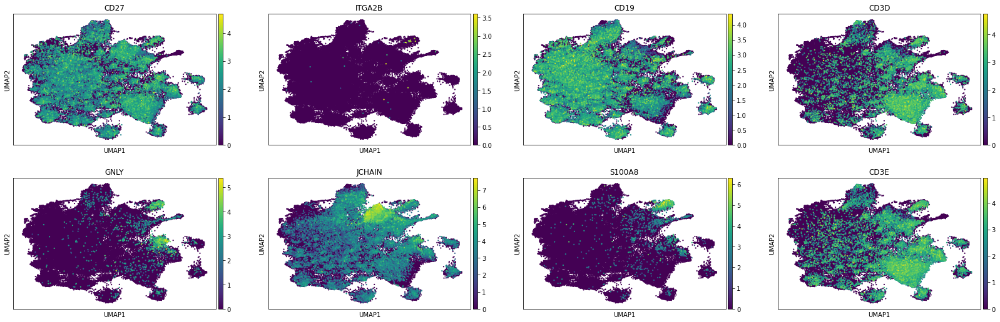

In [234]:
#Explore expression of key B cell/doublet/non B cell genes
sc.pl.umap(rna_x, color = ['CD27', 'ITGA2B', 'CD19', 'CD3D', 'GNLY', 'JCHAIN', 'S100A8', 'CD3E'], size = 20)

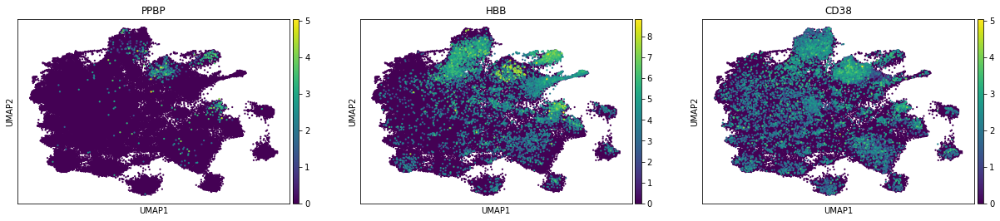

In [236]:
sc.pl.umap(rna_x, color = ['PPBP', 'HBB','CD38'], size = 20)

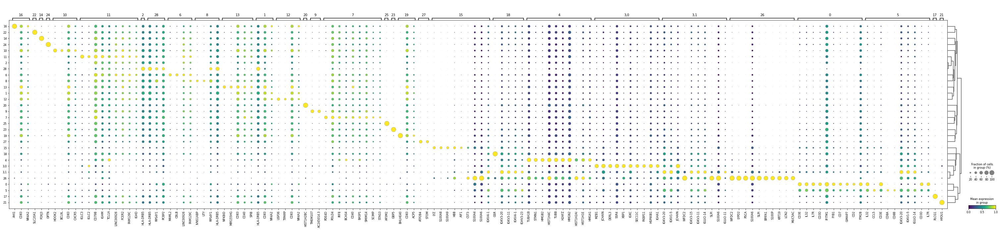

In [242]:
#top 10 DEG ranked dotplot by cluster 
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R2', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R2')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

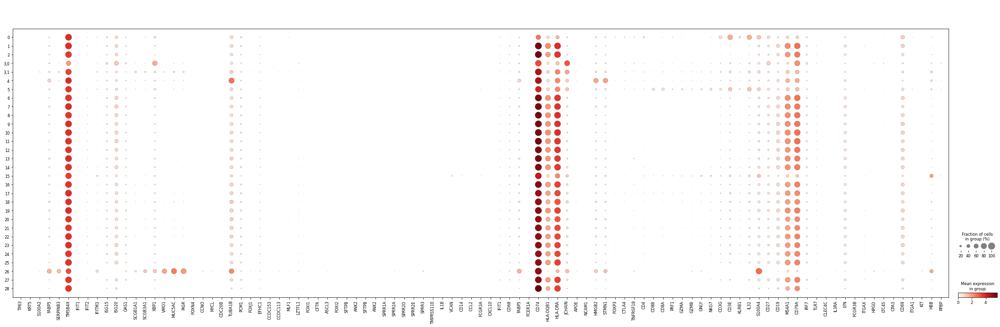

In [243]:
#Chua et al gene expression profiles by cluster 
sc.pl.dotplot(rna_x, Chuafeat, groupby = 'leiden_R2')

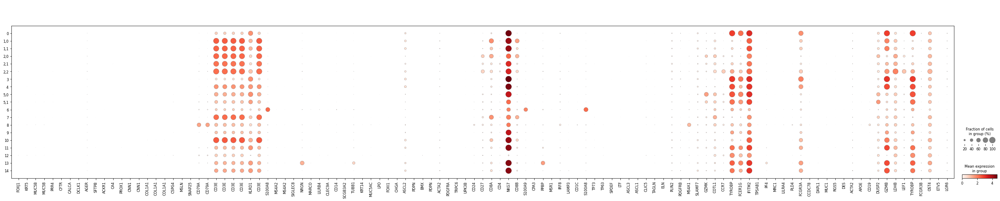

In [206]:
#Travaglini gene expression profiles by cluster 
sc.pl.dotplot(rna_x, Trav_list, groupby = 'leiden_R2.2')

In [275]:
#A collection of key B cell and plasma cell markers for different maturation stages 
Bmark = ['CD19', 'MS4A1','CD38','JCHAIN','MME','CD27','TNFRSF13C', 'TNFRSF13B',
         'TNFRSF17','CR2','CD5','FCER2','CD24','IGHD','IGHM','IGHE','IGHA1','IGHG1', 'HLA-DRA', 'CD79A',
        'CXCR4','CXCR5','CD34','CD86','CD1D','CD74']
Bmark

['CD19',
 'MS4A1',
 'CD38',
 'JCHAIN',
 'MME',
 'CD27',
 'TNFRSF13C',
 'TNFRSF13B',
 'TNFRSF17',
 'CR2',
 'CD5',
 'FCER2',
 'CD24',
 'IGHD',
 'IGHM',
 'IGHE',
 'IGHA1',
 'IGHG1',
 'HLA-DRA',
 'CD79A',
 'CXCR4',
 'CXCR5',
 'CD34',
 'CD86',
 'CD1D',
 'CD74']

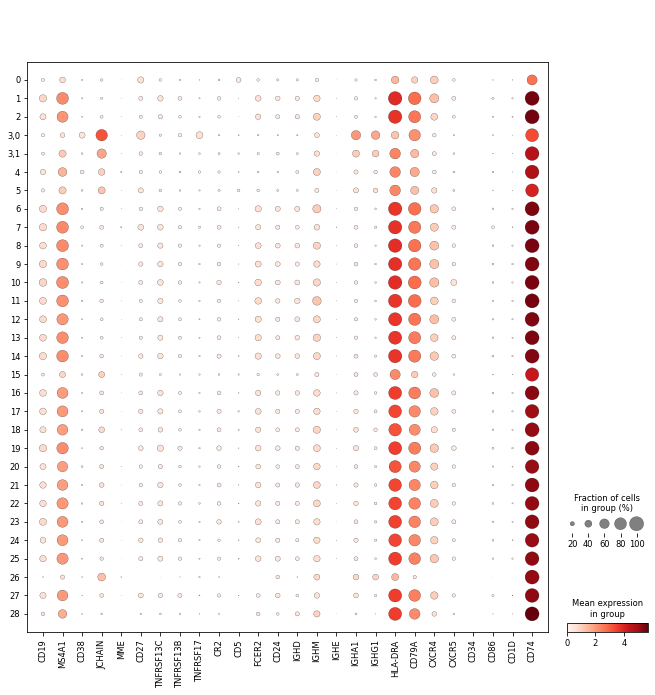

In [276]:
#B cell markers expressed in a dotplot 
sc.pl.dotplot(rna_x,Bmark,groupby='leiden_R2')

... storing 'fine_label' as categorical


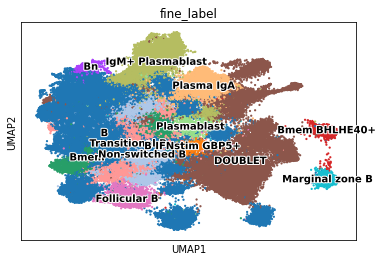

In [281]:
#Name B cells subset clusters in accordance with gene expression profiles above 
new_dict1 = {'0':'DOUBLET',
             '1':'B',
             '2':'B',
             '3,0':'Plasma IgA',
             '3,1':'DOUBLET',
             '4':'IgM+ Plasmablast',
             '5':'DOUBLET',
             '6':'Non-switched B',
             '7':'Bmem',
             '8':'B',
             '9':'B',
             '10':'Follicular B',
             '11':'Non-switched B',
             '12':'Transitional B',
             '13':'Transitional B',
             '14':'B',
             '15':'DOUBLET',
             '16':'Marginal zone B',
             '17':'B',
             '18':'Plasmablast',
             '19':'Bmem BHLHE40+',
             '20':'B',
             '21':'B',
             '22':'B',
             '23':'B IFNstim GBP5+',
             '24':'B',
             '25':'B',
             '26':'DOUBLET',
             '27':'B',
             '28':'Bn'
}
rna_x.obs['fine_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R2']]
sc.pl.umap(rna_x, color=['fine_label'], size=20, legend_loc ='on data', legend_fontoutline=2)

... storing 'fine_label' as categorical


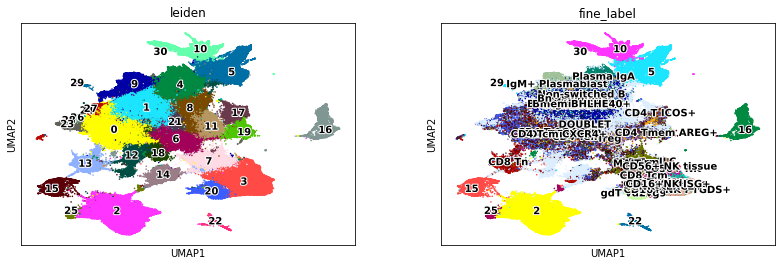

In [282]:
# update the original object with B cell subset annotations 
adata_concat.obs['fine_label'] = adata_concat.obs['fine_label'].astype('object')
adata_concat.obs['fine_label'].update(rna_x.obs['fine_label'].astype('object'))
sc.pl.umap(adata_concat, color = ['leiden', 'fine_label'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

In [285]:
#save for now
adata_concat.write('COV_combined_TNKB-fine_label_060721.h5ad', compression = 'gzip')
adata_concat.raw.to_adata().write('COV_combined_TNKB_fine_label_raw_060721.h5ad', compression = 'gzip')

In [7]:
#load as kernel died
adata_concat = sc.read_h5ad('COV_combined_TNKB-fine_label_060721.h5ad')
adata_concat

AnnData object with n_obs × n_vars = 456439 × 1329
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Cohort_colors', 'Gender_colors', 'Patient_colors', 'Sampleid_colors', 'Sampletype_colors', 'broad_label_colors', 'celltypist_colors', 'dendrogram_leiden', 'fine_label_colors', 'hvg', 'leiden', 'leiden_c

### monocyte/macrophage/DC

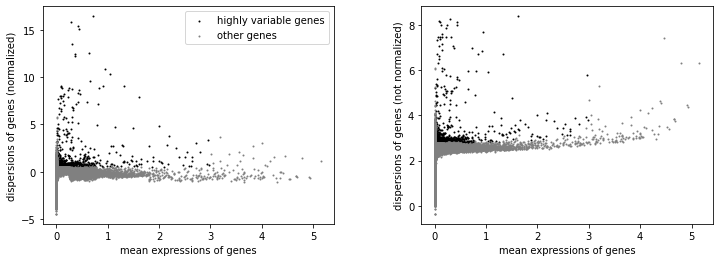

AnnData object with n_obs × n_vars = 53337 × 25675
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'Cohort_colors', 'Gender_colors', 'Patient_colors', 'Sampleid_colors', 'Sampletype_colors', 'broad_label_colors', 'celltypist_colors', 'dendrogram_leiden', 'fine_label_colors', 'hvg', 'leiden', 'leiden_colors', 'neighb

In [9]:
# subset MMP/DC broad labelled clusters. 
rna_ = adata_concat[adata_concat.obs['leiden'].isin(['2'])]
rna_x = sc.AnnData(X = rna_.raw.X, obs = rna_.obs, var = rna_.raw.var, uns = rna_.uns, obsm = rna_.obsm, obsp = rna_.obsp)
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

In [10]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['total_counts', 'pct_counts_mt'])
sc.pp.scale(rna_x, max_value = 10)

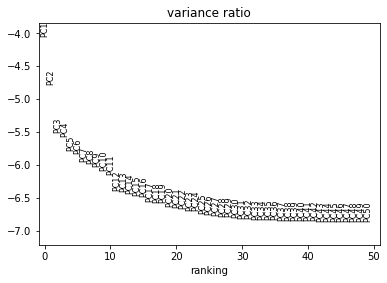

In [11]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

In [12]:
# Computing the neighborhood graph. Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50)

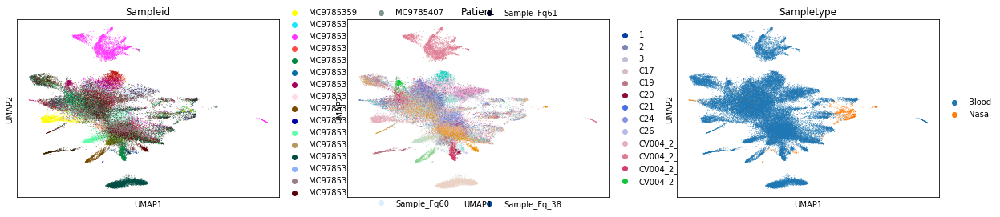

In [13]:
# run UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

In [15]:
# run harmony for batch correction 
sc.external.pp.harmony_integrate(rna_x, 'Patient')
'X_pca_harmony' in rna_x.obsm


2021-07-07 12:36:33,670 - harmonypy - INFO - Iteration 1 of 10
2021-07-07 12:37:15,658 - harmonypy - INFO - Iteration 2 of 10
2021-07-07 12:37:56,453 - harmonypy - INFO - Converged after 2 iterations


True

In [16]:
rna_x

AnnData object with n_obs × n_vars = 53337 × 2024
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Cohort_colors', 'Gender_colors', 'Patient_colors', 'Sampleid_colors', 'Sampletype_colors', 'broad_label_colors', 'celltypist_colors', 'dendrogram_leiden', 'fine_label_colors', 'hvg', 'leiden', 'leiden_co

In [17]:
# Compute the neighborhood graph with harmony correction. Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50, use_rep='X_pca_harmony')

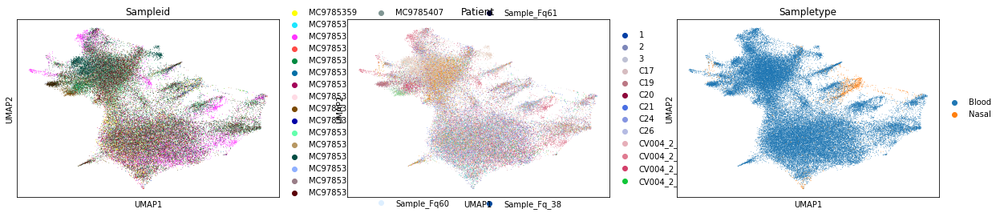

In [18]:
# UMAP with harmony correction 
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

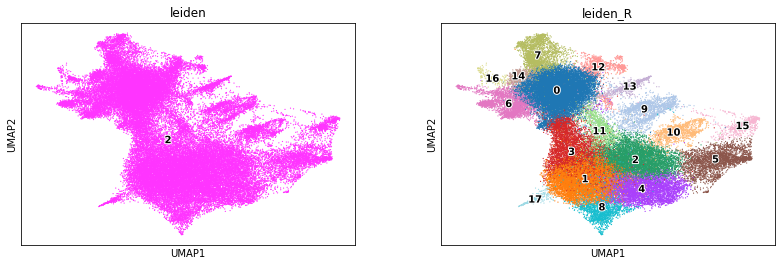

In [23]:
# find clusters in subsetted object. 
sc.tl.leiden(rna_x, resolution = 1, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=6, legend_loc ='on data', legend_fontoutline=2)

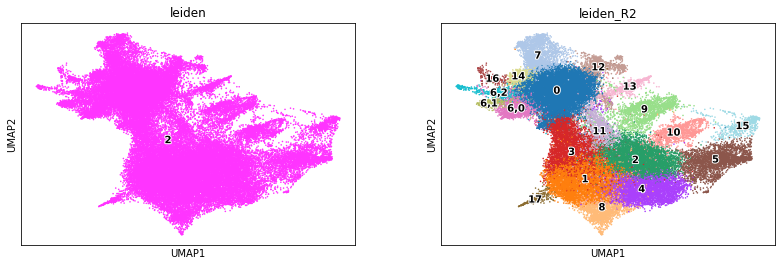

In [24]:
# split clusters
sc.tl.leiden(rna_x, resolution = .2, key_added = 'leiden_R2', restrict_to = ('leiden_R', ['6']))
sc.pl.umap(rna_x, color=['leiden', 'leiden_R2'], size=10, legend_loc ='on data', legend_fontoutline=2)

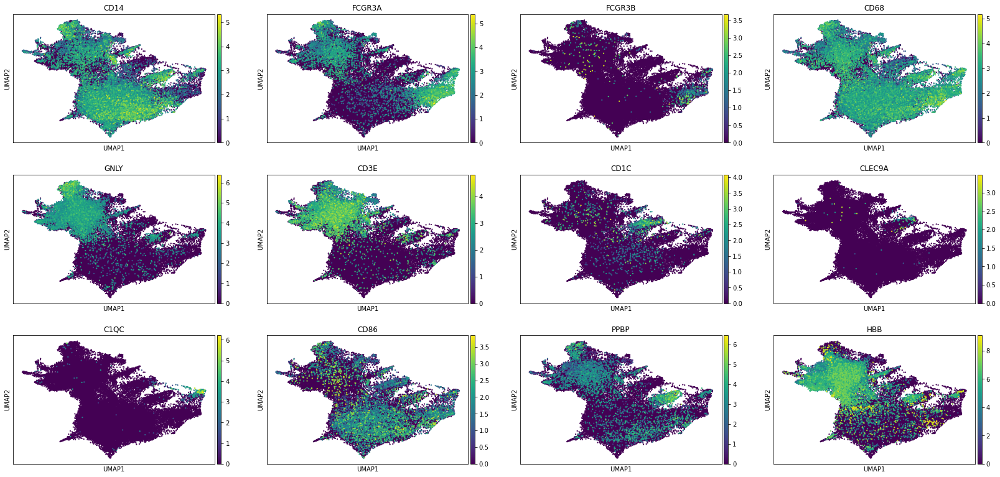

In [26]:
#Review expression of key MMP/DC/Doublet marker genes. 
sc.pl.umap(rna_x, color = ['CD14', 'FCGR3A', 'FCGR3B', 'CD68', 'GNLY', 'CD3E', 'CD1C', 'CLEC9A', 'C1QC', 'CD86', 'PPBP', 'HBB'], size = 20)

categories: 0, 1, 2, etc.
var_group_labels: 0, 1, 2, etc.


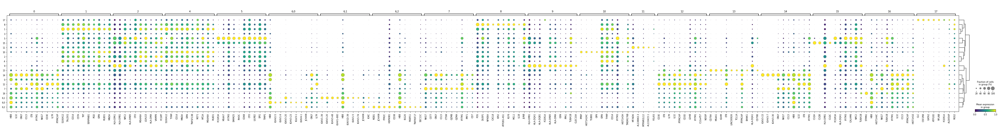

In [32]:
#Top DEG dotplot by cluster 
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R2', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R2')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

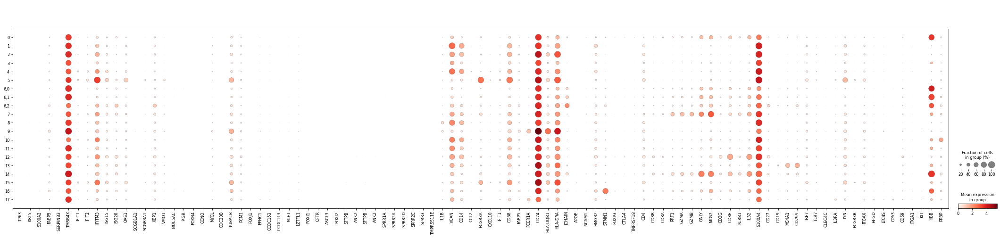

In [33]:
#Chau marker gene expression by cluster 
sc.pl.dotplot(rna_x, Chuafeat, groupby = 'leiden_R2')

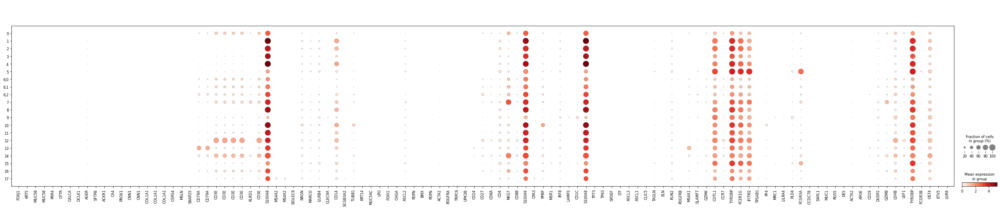

In [35]:
#Travalgini marker gene expression by cluster 
sc.pl.dotplot(rna_x, Trav_list, groupby = 'leiden_R2')

... storing 'fine_label' as categorical


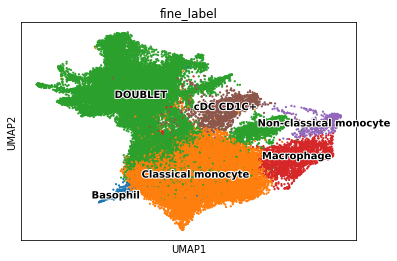

In [41]:
#Label clusters by gene expression profiles 
new_dict1 = {'0':'DOUBLET',
             '1':'Classical monocyte',
             '2':'Classical monocyte',
             '3':'DOUBLET',
             '4':'Classical monocyte',
             '5':'Macrophage',
             '6,0':'DOUBLET',
             '6,1':'DOUBLET',
             '6,2':'DOUBLET',
             '7':'DOUBLET',
             '8':'Classical monocyte',
             '9':'cDC CD1C+',
             '10':'DOUBLET',
             '11':'DOUBLET',
             '12':'DOUBLET',
             '13':'DOUBLET',
             '14':'DOUBLET',
             '15':'Non-classical monocyte',
             '16':'DOUBLET',
             '17':'Basophil'
}
rna_x.obs['fine_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R2']]
sc.pl.umap(rna_x, color=['fine_label'], size=20, legend_loc ='on data', legend_fontoutline=2)

... storing 'fine_label' as categorical


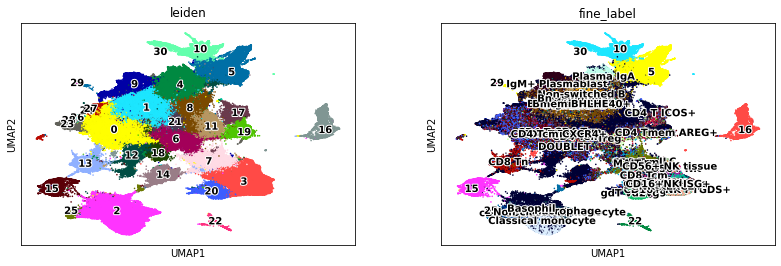

In [42]:
# update the original object
adata_concat.obs['fine_label'] = adata_concat.obs['fine_label'].astype('object')
adata_concat.obs['fine_label'].update(rna_x.obs['fine_label'].astype('object'))
sc.pl.umap(adata_concat, color = ['leiden', 'fine_label'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

In [44]:
#save for now
adata_concat.write('COV_combined_TNKBMMP-fine_label_070721.h5ad', compression = 'gzip')
adata_concat.raw.to_adata().write('COV_combined_TNKBMMP_fine_label_raw_070721.h5ad', compression = 'gzip')

### Epithelial

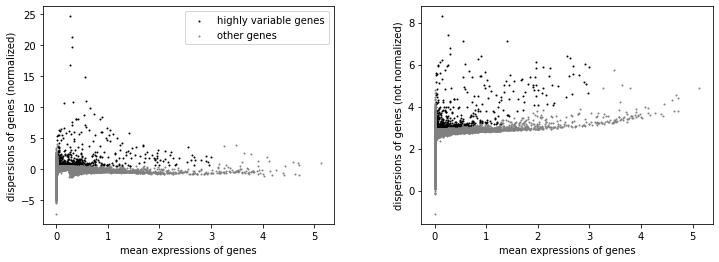

AnnData object with n_obs × n_vars = 44224 × 25675
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'Cohort_colors', 'Gender_colors', 'Patient_colors', 'Sampleid_colors', 'Sampletype_colors', 'broad_label_colors', 'celltypist_colors', 'dendrogram_leiden', 'fine_label_colors', 'hvg', 'leiden', 'leiden_colors', 'neighb

In [45]:
# subset broad label epithelial clusters 
rna_ = adata_concat[adata_concat.obs['leiden'].isin(['5','10','29','30'])]
rna_x = sc.AnnData(X = rna_.raw.X, obs = rna_.obs, var = rna_.raw.var, uns = rna_.uns, obsm = rna_.obsm, obsp = rna_.obsp)
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

In [46]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['total_counts', 'pct_counts_mt'])
sc.pp.scale(rna_x, max_value = 10)

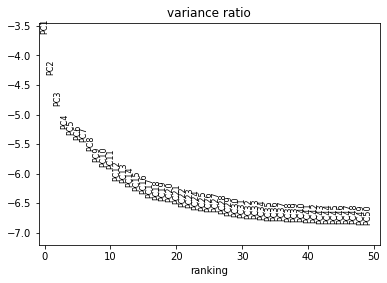

In [47]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

In [48]:
# Computing the neighborhood graph. Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50)

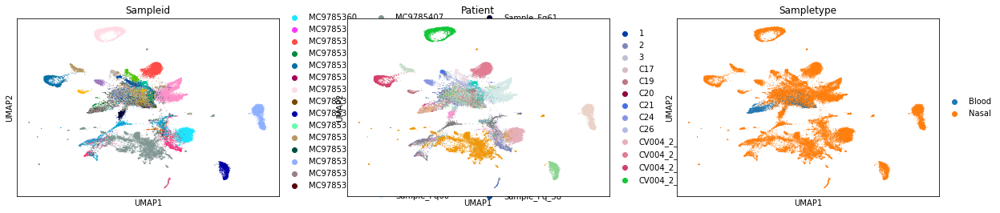

In [49]:
# run UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

In [51]:
# run harmony for bathc correction 
sc.external.pp.harmony_integrate(rna_x, 'Patient')
'X_pca_harmony' in rna_x.obsm


2021-07-07 18:16:52,095 - harmonypy - INFO - Iteration 1 of 10
2021-07-07 18:17:22,560 - harmonypy - INFO - Iteration 2 of 10
2021-07-07 18:17:53,562 - harmonypy - INFO - Converged after 2 iterations


True

In [52]:
rna_x

AnnData object with n_obs × n_vars = 44224 × 1836
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Cohort_colors', 'Gender_colors', 'Patient_colors', 'Sampleid_colors', 'Sampletype_colors', 'broad_label_colors', 'celltypist_colors', 'dendrogram_leiden', 'fine_label_colors', 'hvg', 'leiden', 'leiden_co

In [53]:
# Compute the neighborhood graph with harmony correction. Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50, use_rep='X_pca_harmony')

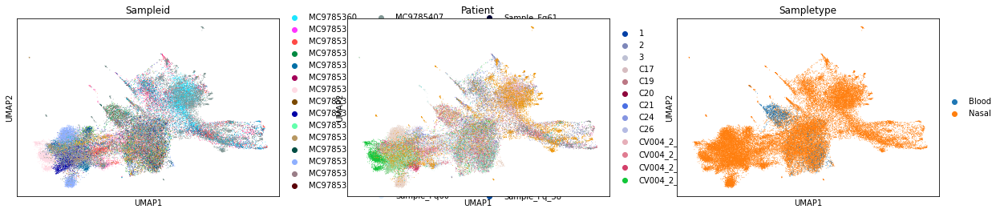

In [54]:
# UMAP with harmony correction 
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

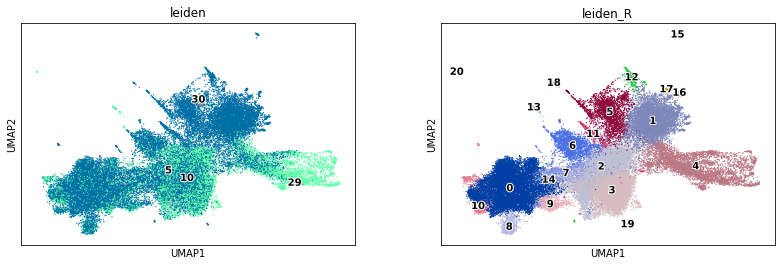

In [58]:
# find clusters in subet object 
sc.tl.leiden(rna_x, resolution = 0.8, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=6, legend_loc ='on data', legend_fontoutline=2)

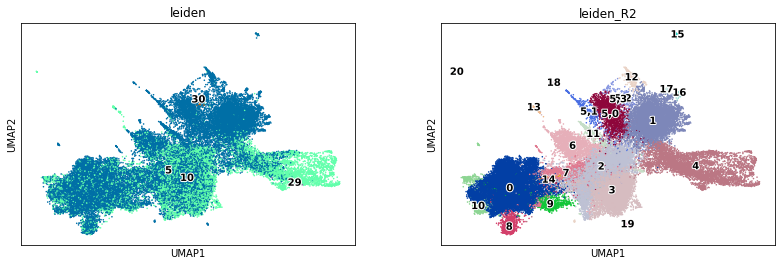

In [59]:
# split clusters
sc.tl.leiden(rna_x, resolution = .2, key_added = 'leiden_R2', restrict_to = ('leiden_R', ['5']))
sc.pl.umap(rna_x, color=['leiden', 'leiden_R2'], size=10, legend_loc ='on data', legend_fontoutline=2)

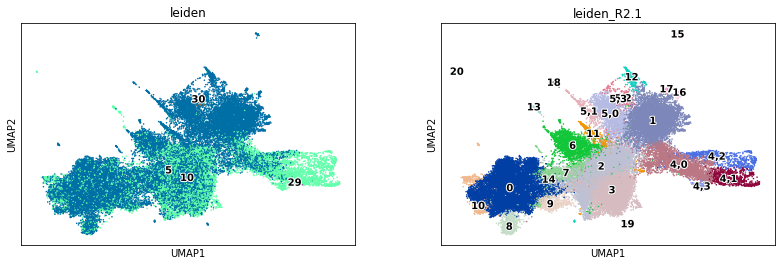

In [60]:
# split clusters
sc.tl.leiden(rna_x, resolution = .2, key_added = 'leiden_R2.1', restrict_to = ('leiden_R2', ['4']))
sc.pl.umap(rna_x, color=['leiden', 'leiden_R2.1'], size=10, legend_loc ='on data', legend_fontoutline=2)

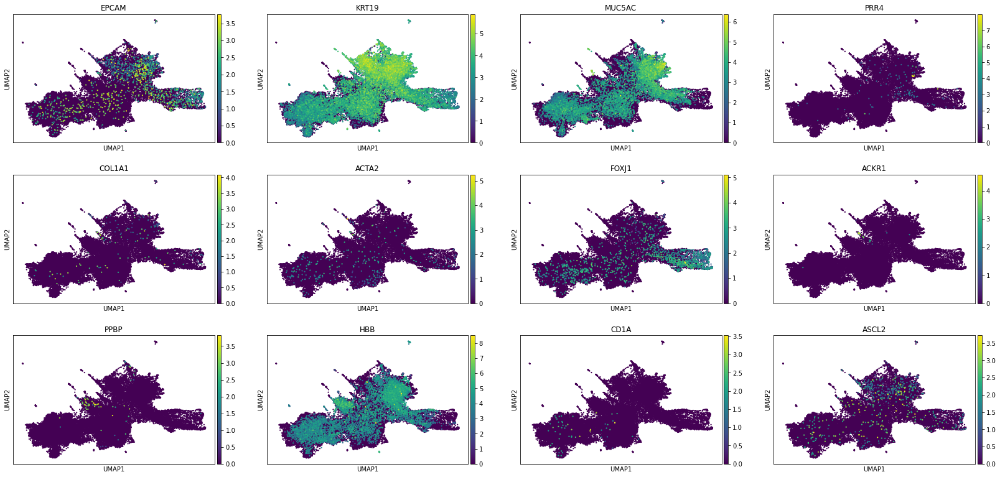

In [73]:
#Explore expression of key epithelial marker genes 
sc.pl.umap(rna_x, color = ['EPCAM','KRT19','MUC5AC','PRR4','COL1A1','ACTA2','FOXJ1','ACKR1','PPBP', 'HBB','CD1A','ASCL2'], size = 20)

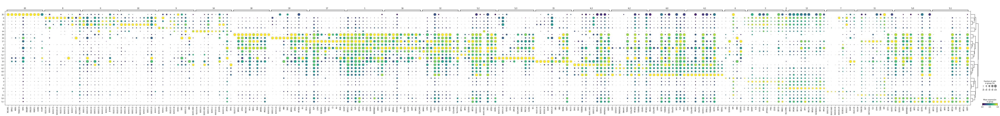

In [62]:
#Top 10 DEG by cluster 
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R2.1', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R2.1')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

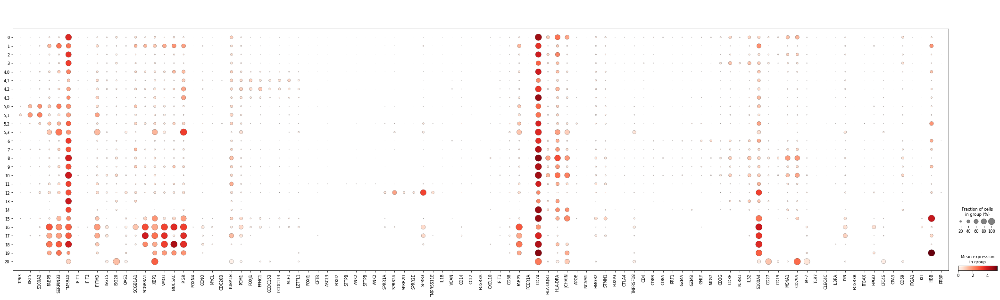

In [63]:
#Chua marker gene expression profiles by cluster
sc.pl.dotplot(rna_x, Chuafeat, groupby = 'leiden_R2.1')

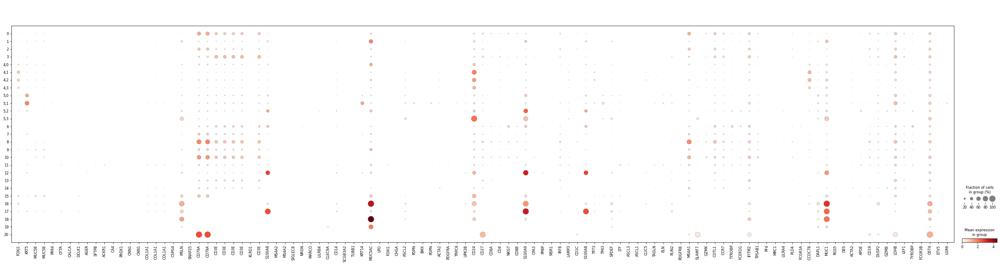

In [64]:
#Travaglini marker gene expression profiles by cluster
sc.pl.dotplot(rna_x, Trav_list, groupby = 'leiden_R2.1')

... storing 'fine_label' as categorical


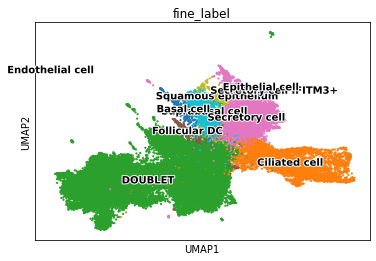

In [75]:
#Name clusters based on gene expression profiles 
new_dict1 = {'0':'DOUBLET',
             '1':'Secretory cell',
             '2':'DOUBLET',
             '3':'DOUBLET',
             '4,0':'Ciliated cell',
             '4,1':'Ciliated cell',
             '4,2':'Ciliated cell',
             '4,3':'Ciliated cell',
             '5,0':'Suprabasal cell',
             '5,1':'Basal cell',
             '5,2':'Squamous epithelium',
             '5,3':'DOUBLET',
             '6':'DOUBLET',
             '7':'DOUBLET',
             '8':'DOUBLET',
             '9':'DOUBLET',
             '10':'DOUBLET',
             '11':'Follicular DC',
             '12':'Secretory cell',
             '13':'DOUBLET',
             '14':'DOUBLET',
             '15':'DOUBLET',
             '16':'Secretory cell IFITM3+',
             '17':'Epithelial cell',
             '18':'Secretory cell',
             '19':'DOUBLET',
             '20':'Endothelial cell'
             
             
}
rna_x.obs['fine_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R2.1']]
sc.pl.umap(rna_x, color=['fine_label'], size=20, legend_loc ='on data', legend_fontoutline=2)

In [ ]:
# update the original object
adata_concat.obs['fine_label'] = adata_concat.obs['fine_label'].astype('object')
adata_concat.obs['fine_label'].update(rna_x.obs['fine_label'].astype('object'))

In [78]:
#save for now
adata_concat.write('COV_combined_TNKBMMPepi-fine_label_070721.h5ad', compression = 'gzip')
adata_concat.raw.to_adata().write('COV_combined_TNKBMMPepi_fine_label_raw_070721.h5ad', compression = 'gzip')

### pDC

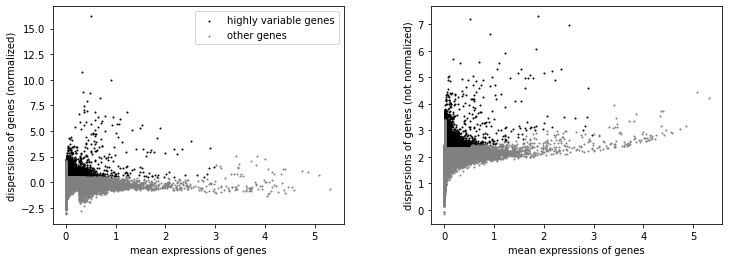

AnnData object with n_obs × n_vars = 2382 × 25675
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'Cohort_colors', 'Gender_colors', 'Patient_colors', 'Sampleid_colors', 'Sampletype_colors', 'broad_label_colors', 'celltypist_colors', 'dendrogram_leiden', 'fine_label_colors', 'hvg', 'leiden', 'leiden_colors', 'neighbo

In [80]:
# subset cells with pDC broad label 
rna_ = adata_concat[adata_concat.obs['leiden'].isin(['22'])]
rna_x = sc.AnnData(X = rna_.raw.X, obs = rna_.obs, var = rna_.raw.var, uns = rna_.uns, obsm = rna_.obsm, obsp = rna_.obsp)
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

In [81]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['total_counts', 'pct_counts_mt'])
sc.pp.scale(rna_x, max_value = 10)

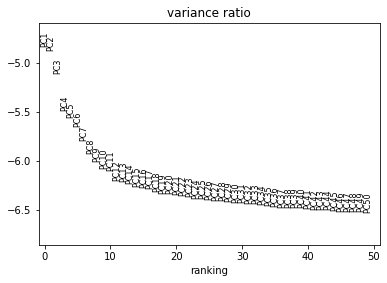

In [82]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

In [83]:
# Computing the neighborhood graph. Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50)

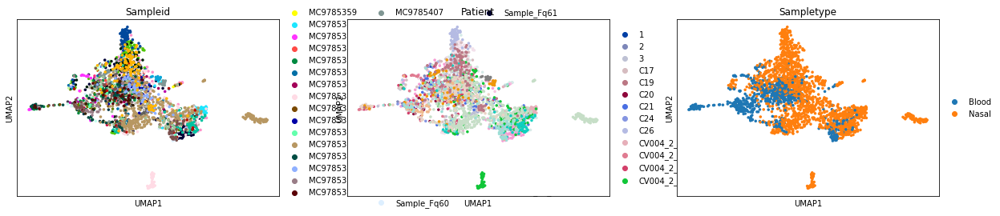

In [84]:
# run UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

In [90]:
# run harmony batch correction 
sc.external.pp.harmony_integrate(rna_x, 'Patient')
'X_pca_harmony' in rna_x.obsm


2021-07-07 22:14:49,238 - harmonypy - INFO - Iteration 1 of 10
2021-07-07 22:14:50,935 - harmonypy - INFO - Iteration 2 of 10
2021-07-07 22:14:52,941 - harmonypy - INFO - Iteration 3 of 10
2021-07-07 22:14:53,862 - harmonypy - INFO - Iteration 4 of 10
2021-07-07 22:14:54,550 - harmonypy - INFO - Iteration 5 of 10
2021-07-07 22:14:55,259 - harmonypy - INFO - Iteration 6 of 10
2021-07-07 22:14:56,147 - harmonypy - INFO - Iteration 7 of 10
2021-07-07 22:14:57,054 - harmonypy - INFO - Iteration 8 of 10
2021-07-07 22:14:57,939 - harmonypy - INFO - Iteration 9 of 10
2021-07-07 22:14:58,636 - harmonypy - INFO - Iteration 10 of 10
2021-07-07 22:14:59,534 - harmonypy - INFO - Stopped before convergence


True

In [91]:
rna_x

AnnData object with n_obs × n_vars = 2382 × 3977
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Cohort_colors', 'Gender_colors', 'Patient_colors', 'Sampleid_colors', 'Sampletype_colors', 'broad_label_colors', 'celltypist_colors', 'dendrogram_leiden', 'fine_label_colors', 'hvg', 'leiden', 'leiden_col

In [92]:
# Compute the neighborhood graph with harmony batch correction . Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50, use_rep='X_pca_harmony')

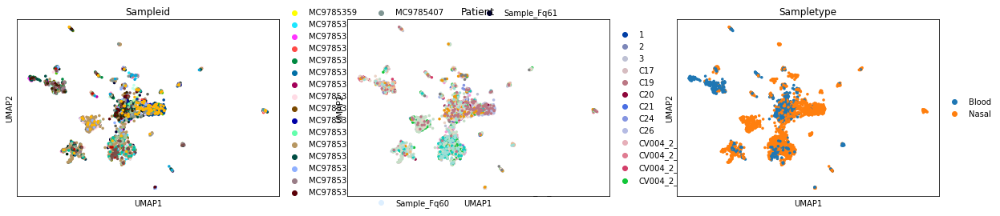

In [93]:
# UMAP with harmony batch correction 
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

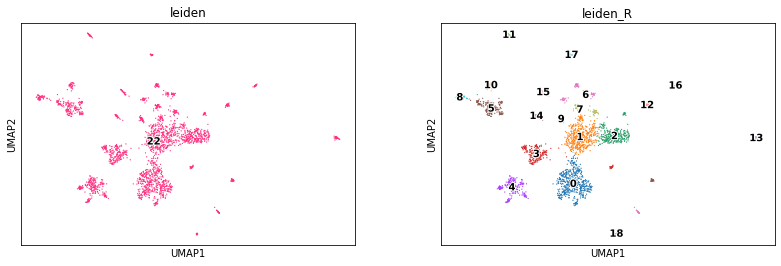

In [95]:
# find clusters in subset object 
sc.tl.leiden(rna_x, resolution = 0.5, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=6, legend_loc ='on data', legend_fontoutline=2)

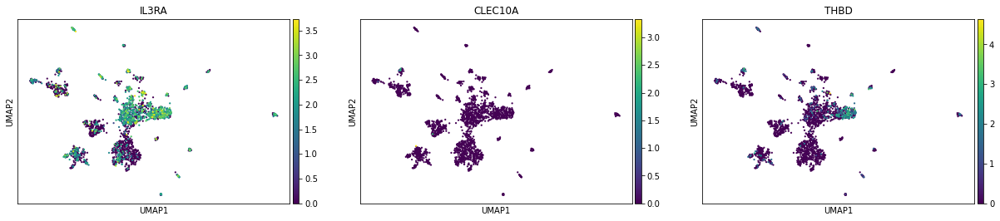

In [104]:
#Some DC/pDC related marker gene expression 
sc.pl.umap(rna_x, color = ['IL3RA','CLEC10A','THBD'], size = 20)

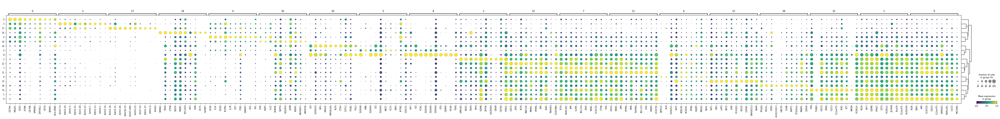

In [98]:
#Top 10 DEG by cluster 
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

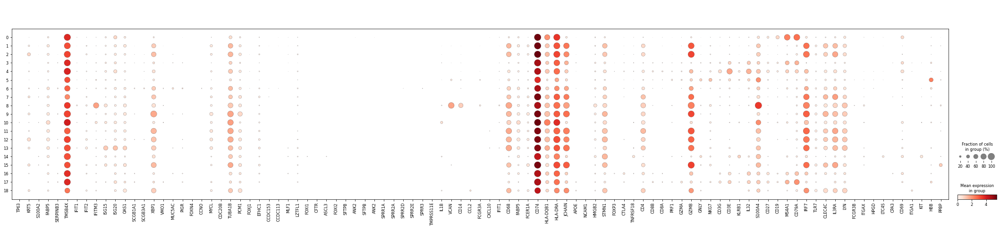

In [99]:
#Chua marker gene expression by cluster 
sc.pl.dotplot(rna_x, Chuafeat, groupby = 'leiden_R')

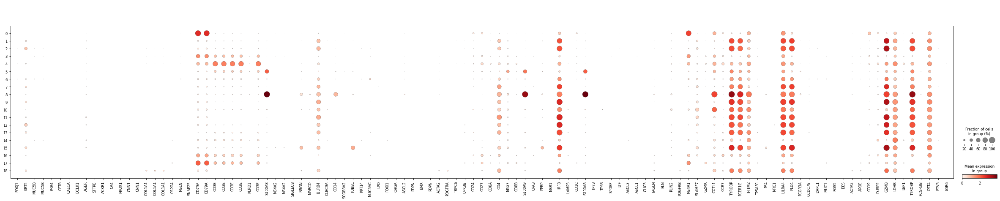

In [100]:
#Travaglini marker gene expression by cluster 
sc.pl.dotplot(rna_x, Trav_list, groupby = 'leiden_R')

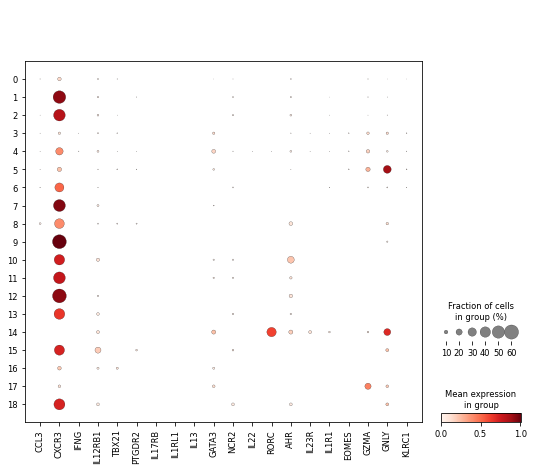

In [101]:
#Bjorkland ILC marker genes by cluster 
sc.pl.dotplot(rna_x, ILC_Bjorkland, groupby = 'leiden_R')

... storing 'fine_label' as categorical


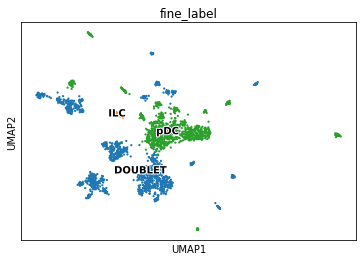

In [106]:
#Rename subset clusters based on gene expression profiles 
new_dict1 = {'0':'DOUBLET',
             '1':'pDC',
             '2':'pDC',
             '3':'DOUBLET',
             '4':'DOUBLET',
             '5':'DOUBLET',
             '6':'DOUBLET',
             '7':'pDC',
             '8':'DOUBLET',
             '9':'pDC',
             '10':'pDC',
             '11':'pDC',
             '12':'pDC',
             '13':'pDC',
             '14':'ILC',
             '15':'pDC',
             '16':'DOUBLET',
             '17':'DOUBLET',
             '18':'pDC'
             
             
}
rna_x.obs['fine_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R']]
sc.pl.umap(rna_x, color=['fine_label'], size=20, legend_loc ='on data', legend_fontoutline=2)

In [ ]:
# update the original object
adata_concat.obs['fine_label'] = adata_concat.obs['fine_label'].astype('object')
adata_concat.obs['fine_label'].update(rna_x.obs['fine_label'].astype('object'))

In [112]:
#save for now
adata_concat.write('COV_combined_TNKBMMPepipDC-fine_label_070721.h5ad', compression = 'gzip')
adata_concat.raw.to_adata().write('COV_combined_TNKBMMPepipDC_fine_label_raw_070721.h5ad', compression = 'gzip')

### Megakaryocyte and erythrocyte

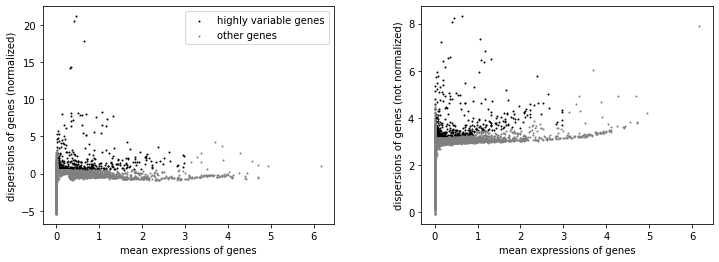

AnnData object with n_obs × n_vars = 19419 × 25675
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'Cohort_colors', 'Gender_colors', 'Patient_colors', 'Sampleid_colors', 'Sampletype_colors', 'broad_label_colors', 'celltypist_colors', 'dendrogram_leiden', 'fine_label_colors', 'hvg', 'leiden', 'leiden_colors', 'neighb

In [113]:
# subset broad labelled megakaryocytes and red cells 
rna_ = adata_concat[adata_concat.obs['leiden'].isin(['15', '16'])]
rna_x = sc.AnnData(X = rna_.raw.X, obs = rna_.obs, var = rna_.raw.var, uns = rna_.uns, obsm = rna_.obsm, obsp = rna_.obsp)
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

In [114]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['total_counts', 'pct_counts_mt'])
sc.pp.scale(rna_x, max_value = 10)

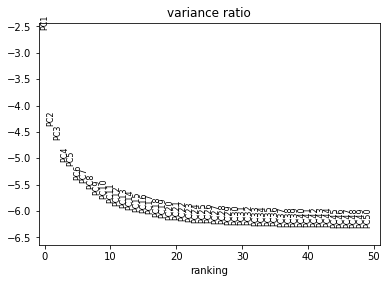

In [115]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

In [116]:
# Computing the neighborhood graph. Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50)

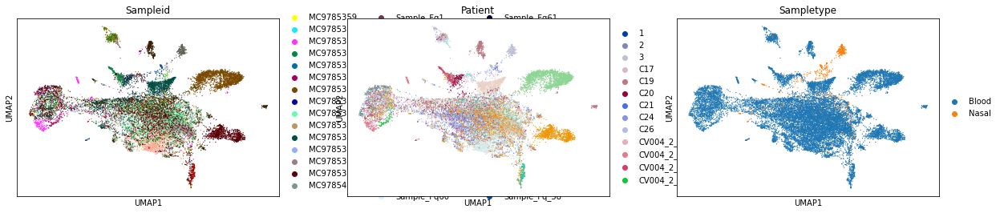

In [117]:
# run UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

In [119]:
# run harmony for batch correction 
sc.external.pp.harmony_integrate(rna_x, 'Patient')
'X_pca_harmony' in rna_x.obsm


2021-07-07 23:24:36,856 - harmonypy - INFO - Iteration 1 of 10
2021-07-07 23:24:58,043 - harmonypy - INFO - Iteration 2 of 10
2021-07-07 23:25:18,942 - harmonypy - INFO - Iteration 3 of 10
2021-07-07 23:25:40,258 - harmonypy - INFO - Iteration 4 of 10
2021-07-07 23:25:52,442 - harmonypy - INFO - Iteration 5 of 10
2021-07-07 23:26:15,052 - harmonypy - INFO - Iteration 6 of 10
2021-07-07 23:26:26,057 - harmonypy - INFO - Iteration 7 of 10
2021-07-07 23:26:43,035 - harmonypy - INFO - Iteration 8 of 10
2021-07-07 23:27:04,451 - harmonypy - INFO - Iteration 9 of 10
2021-07-07 23:27:15,634 - harmonypy - INFO - Iteration 10 of 10
2021-07-07 23:27:37,143 - harmonypy - INFO - Stopped before convergence


True

In [120]:
rna_x

AnnData object with n_obs × n_vars = 19419 × 1154
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Cohort_colors', 'Gender_colors', 'Patient_colors', 'Sampleid_colors', 'Sampletype_colors', 'broad_label_colors', 'celltypist_colors', 'dendrogram_leiden', 'fine_label_colors', 'hvg', 'leiden', 'leiden_co

In [121]:
# Compute the neighborhood graph with harmony correction . Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50, use_rep='X_pca_harmony')

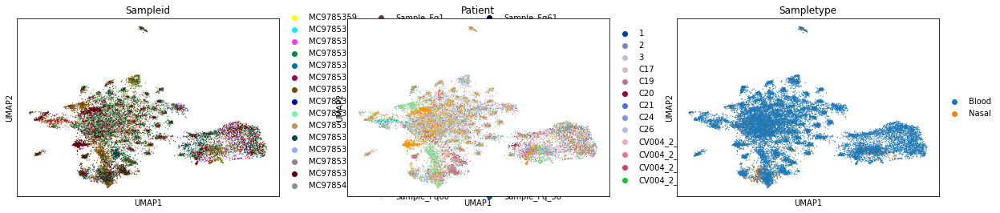

In [122]:
# UMAP with harmony correction 
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

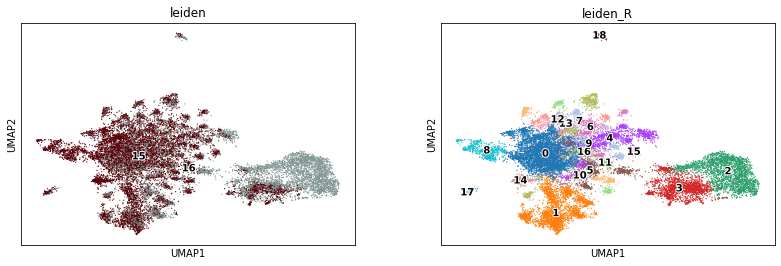

In [124]:
# find subset clusters
sc.tl.leiden(rna_x, resolution = 0.5, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=6, legend_loc ='on data', legend_fontoutline=2)

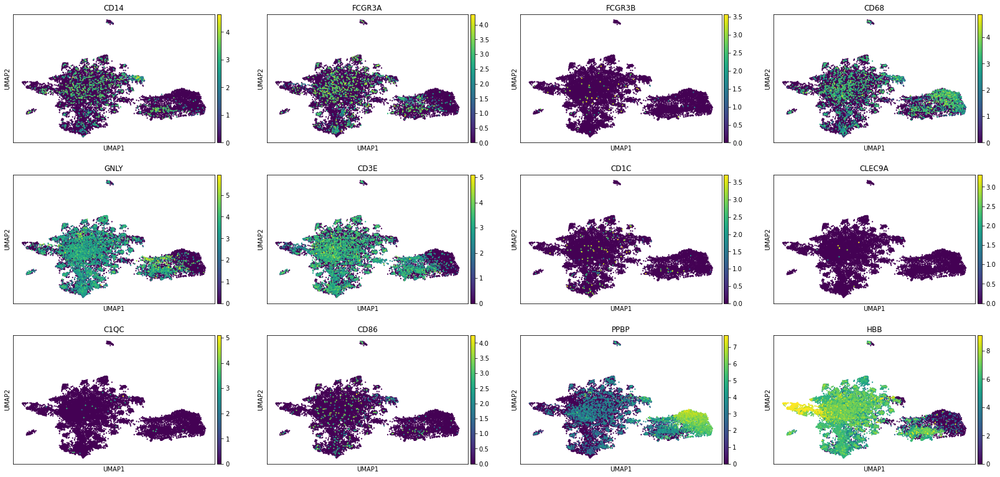

In [126]:
#Marker genes of key celltypes given high likelihood of doublets
sc.pl.umap(rna_x, color = ['CD14', 'FCGR3A', 'FCGR3B', 'CD68', 'GNLY', 'CD3E', 'CD1C', 'CLEC9A', 'C1QC', 'CD86', 'PPBP', 'HBB'], size = 20)

categories: 0, 1, 2, etc.
var_group_labels: 1, 2, 3, etc.


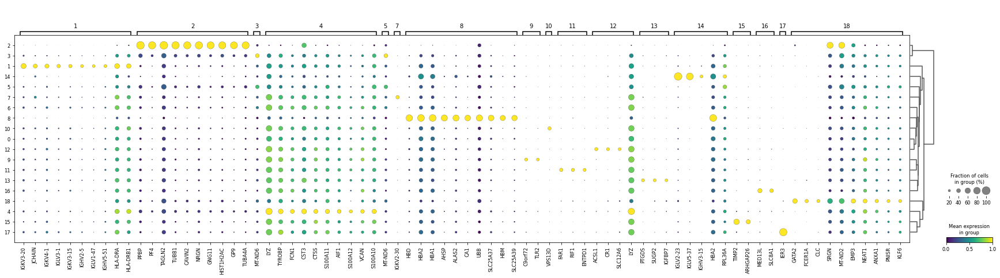

In [127]:
#Top 10 DEG by cluster 
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

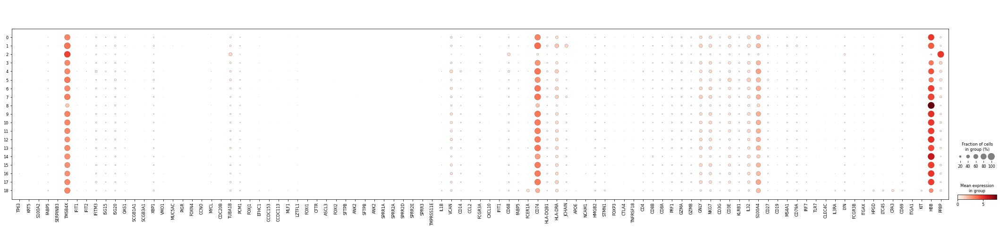

In [129]:
#Chua marker genes by cluster 
sc.pl.dotplot(rna_x,Chuafeat,groupby ='leiden_R')

... storing 'fine_label' as categorical


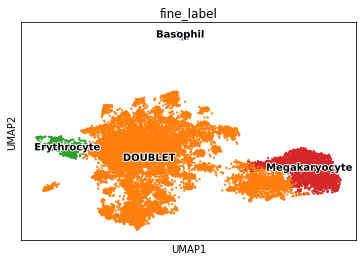

In [130]:
#Name subset clusters based on gene expression profiles 
new_dict1 = {'0':'DOUBLET',
             '1':'DOUBLET',
            '2':'Megakaryocyte',
             '3':'DOUBLET',
             '4':'DOUBLET',
             '5':'DOUBLET',
             '6':'DOUBLET',
             '7':'DOUBLET',
            '8':'Erythrocyte',
             '9':'DOUBLET',
             '10':'DOUBLET',
             '11':'DOUBLET',
             '12':'DOUBLET',
             '13':'DOUBLET',
             '14':'DOUBLET',
             '15':'DOUBLET',
             '16':'DOUBLET',
             '17':'DOUBLET',
            '18':'Basophil'}
rna_x.obs['fine_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R']]
sc.pl.umap(rna_x, color=['fine_label'], size=20, legend_loc ='on data', legend_fontoutline=2)

In [ ]:
# update the original object
adata_concat.obs['fine_label'] = adata_concat.obs['fine_label'].astype('object')
adata_concat.obs['fine_label'].update(rna_x.obs['fine_label'].astype('object'))

### Mast

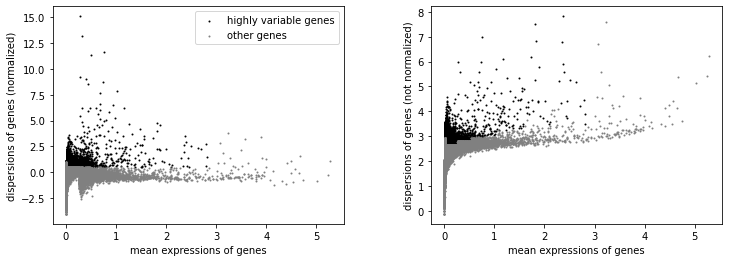

AnnData object with n_obs × n_vars = 1512 × 25675
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'Cohort_colors', 'Gender_colors', 'Patient_colors', 'Sampleid_colors', 'Sampletype_colors', 'broad_label_colors', 'celltypist_colors', 'dendrogram_leiden', 'fine_label_colors', 'hvg', 'leiden', 'leiden_colors', 'neighbo

In [132]:
# subset Mast cell broad cluster 
rna_ = adata_concat[adata_concat.obs['leiden'].isin(['25'])]
rna_x = sc.AnnData(X = rna_.raw.X, obs = rna_.obs, var = rna_.raw.var, uns = rna_.uns, obsm = rna_.obsm, obsp = rna_.obsp)
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

In [133]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['total_counts', 'pct_counts_mt'])
sc.pp.scale(rna_x, max_value = 10)

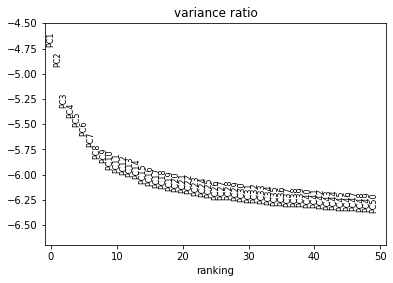

In [134]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

In [135]:
# Computing the neighborhood graph. Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50)

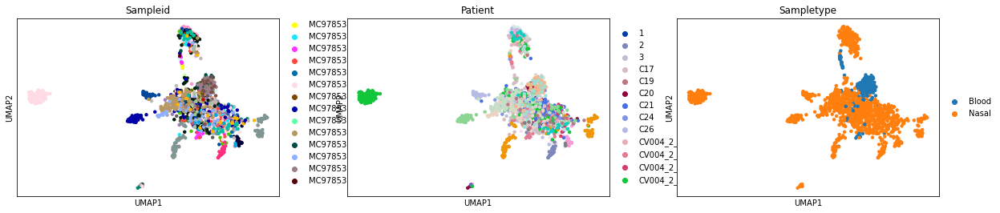

In [136]:
# run UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

In [138]:
# run harmony for batch correction
sc.external.pp.harmony_integrate(rna_x, 'Patient')
'X_pca_harmony' in rna_x.obsm


2021-07-07 23:50:29,147 - harmonypy - INFO - Iteration 1 of 10
2021-07-07 23:50:29,842 - harmonypy - INFO - Iteration 2 of 10
2021-07-07 23:50:30,534 - harmonypy - INFO - Iteration 3 of 10
2021-07-07 23:50:31,042 - harmonypy - INFO - Iteration 4 of 10
2021-07-07 23:50:31,663 - harmonypy - INFO - Iteration 5 of 10
2021-07-07 23:50:32,149 - harmonypy - INFO - Iteration 6 of 10
2021-07-07 23:50:32,555 - harmonypy - INFO - Iteration 7 of 10
2021-07-07 23:50:32,860 - harmonypy - INFO - Iteration 8 of 10
2021-07-07 23:50:33,163 - harmonypy - INFO - Iteration 9 of 10
2021-07-07 23:50:33,526 - harmonypy - INFO - Iteration 10 of 10
2021-07-07 23:50:33,829 - harmonypy - INFO - Stopped before convergence


True

In [139]:
rna_x

AnnData object with n_obs × n_vars = 1512 × 4598
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Cohort_colors', 'Gender_colors', 'Patient_colors', 'Sampleid_colors', 'Sampletype_colors', 'broad_label_colors', 'celltypist_colors', 'dendrogram_leiden', 'fine_label_colors', 'hvg', 'leiden', 'leiden_col

In [140]:
# Compute the neighborhood graph based on harmony correction (not didn't converge). Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50, use_rep='X_pca_harmony')

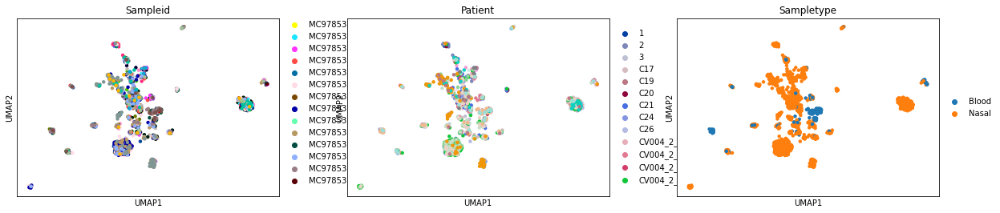

In [141]:
# UMAP based on harmoyn correction
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

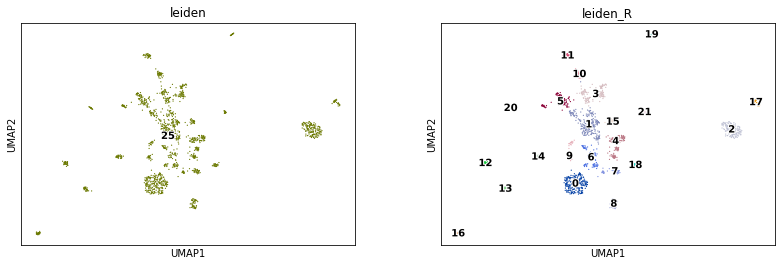

In [143]:
# find clusters in subset object 
sc.tl.leiden(rna_x, resolution = 0.5, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=6, legend_loc ='on data', legend_fontoutline=2)

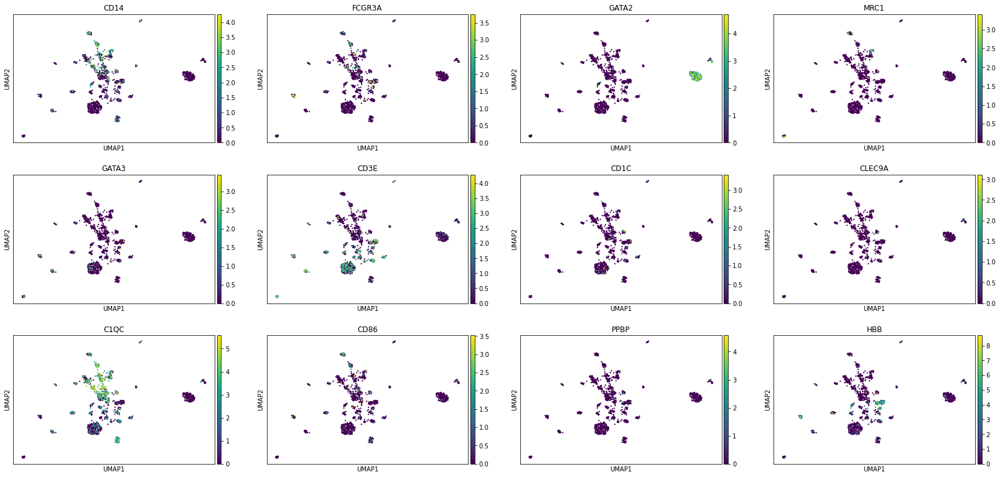

In [151]:
#Explore gene expression in clusters 
sc.pl.umap(rna_x, color = ['CD14', 'FCGR3A','GATA2','MRC1','GATA3', 'CD3E', 'CD1C', 'CLEC9A', 'C1QC', 'CD86', 'PPBP', 'HBB'], size = 20)

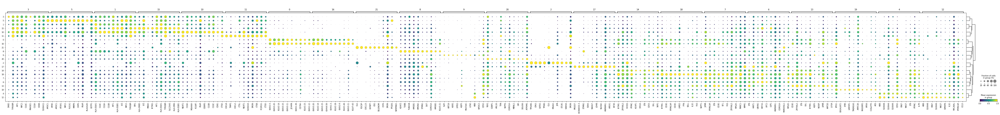

In [146]:
#Top 10 DEG by cluster 
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

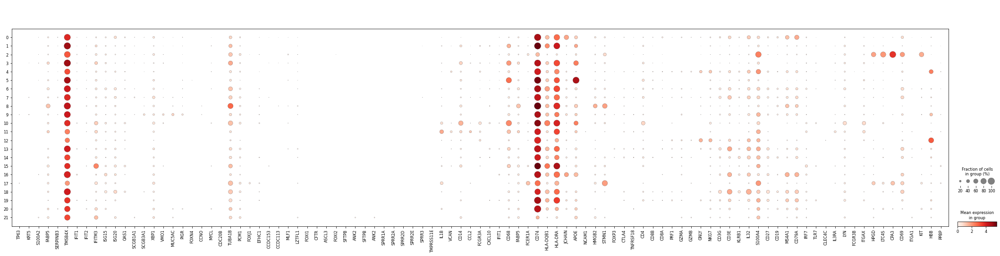

In [150]:
#Chua marker gene expression profiles by cluster 
sc.pl.dotplot(rna_x,Chuafeat,groupby ='leiden_R')

... storing 'fine_label' as categorical


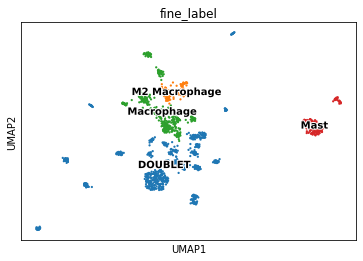

In [154]:
#Rename clusters based on gene expression profiles. 
new_dict1 = {'0':'DOUBLET',
             '1':'Macrophage',
             '2':'Mast',
             '3':'M2 Macrophage',
             '4':'DOUBLET',
             '5':'Macrophage',
             '6':'DOUBLET',
             '7':'DOUBLET',
             '8':'DOUBLET',
             '9':'DOUBLET',
             '10':'Macrophage',
             '11':'Macrophage',
             '12':'DOUBLET',
             '13':'DOUBLET',
             '14':'DOUBLET',
             '15':'Macrophage',
             '16':'DOUBLET',
            '17':'Mast',
            '18':'DOUBLET',
            '19':'DOUBLET',
            '20':'DOUBLET',
            '21':'DOUBLET'}
rna_x.obs['fine_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R']]
sc.pl.umap(rna_x, color=['fine_label'], size=20, legend_loc ='on data', legend_fontoutline=2)

... storing 'fine_label' as categorical


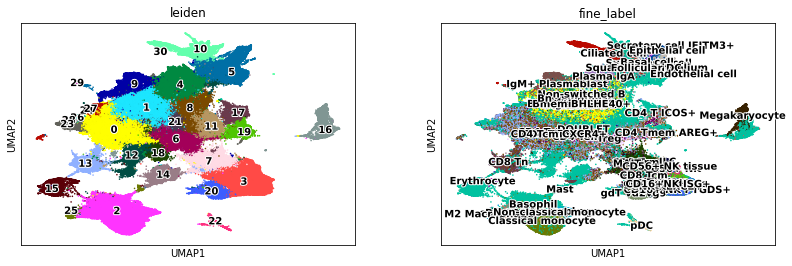

In [155]:
# update the original object
adata_concat.obs['fine_label'] = adata_concat.obs['fine_label'].astype('object')
adata_concat.obs['fine_label'].update(rna_x.obs['fine_label'].astype('object'))
sc.pl.umap(adata_concat, color = ['leiden', 'fine_label'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

In [156]:
#save fully annotated first itteration (for reloading in new notebook for removal of doublets and reclustering)
adata_concat.write('COV_combined_all_fine_label_070721.h5ad', compression = 'gzip')
adata_concat.raw.to_adata().write('COV_combined_all_fine_label_raw_070721.h5ad', compression = 'gzip')